# Performance of Tabular Methods on Different Environments

### Group Members:
#### Yee Qing Wei (AIT2104019)
#### Lang Kah Chun (AIT2102005)
#### Sun Qi Yang (AIT2104016)

## Introduction

#### Reinforcement learning is widely used to determine the movement of robot in an environment. It increases the efficency of various tasks being performed by humans. For example, restaurant owners can use waiter robots to serve dishes to customer. While the cost of purchasing robots is expensive at first, waiter robot can perform its task in shorter amount of time while not requiring much money to spend on afterwards (salary, EPF, paid leave). 
#### Reinforcement learning agent relies on its current position (current state) and a policy to determine where it should go at any given time. During training phase, an agent will go through different states to obtain the expected return (V value) of a state or an episode of states. These expected return will then be evaluated into a policy to determine what action it should perform at a certain state.
#### Tabular reinforcement learning is one reinforcement learning algorithm that can approximate V value functions into table forms. It will be rather easy to evaluate these functions as they are not complicated in the first place. There are various reinforcement learning algorithms we can use. Each of them has different ways to train V value functions and/or approximate them into policy. It is important to know that our real world will be consist of different environment for an agent to train. Therefore, there is no such single algorithm that can complete tasks accurately in shortest amount of time, every single time. 

## Problem Formulation

#### It is undistupable that one will prefer an algorithm that can move to the correct location in a short amount of time. For instance, a robot is basically unfunctionable if it keep runs into a wall or moves back and forth between two random locations. A reinforcement algorithm that takes too many time steps to reach to a destination not far away is also considered as a bad algorithm by the eyes of many. People prefer the algorithm that perform the best in an environment, even if it's slightly better than the others. This small change can have huge time improvement for an agent to perform its task repetitively.
### Thus, the problem this assignment project is trying to solve is which tabular reinforcement learning algorithm performs the best, in terms of accuracy and time spend, to move from one point to another in different windy environments. 

---
## Installing Dependencies

In [1]:
# Install Gym for Environment
#!pip install gym

---
## Importing Libraries
#### - First 6 imported libraries are mainly used throughout the code.
#### - Remaining 4 libraries are used to get access to OpenAI gym libraries

In [2]:
import sys
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import time

import gym
from gym import spaces
from gym.utils import seeding
from gym import Wrapper

----
## Flow of the notebook:

### Agent settings
#### - We had set 7 types of agents to solve each of the environments including Random, Dynamic Programming, SARSA, Expected SARSA, Q-learning, Monte Carlo and N-Step temporal Difference. 

### Environment settings
#### - First section will be about explaining result of few agents trained on simple King Windy Grid World

#### - Second section will be about the training of agents on stochastic King Windy Grid World

#### - Third section will be about the results found from customized trappy King Windy Grid World

#### Here we slightly modified the original render method by using Wrapper. Two different wrappers are being designed to modify the existing env.render() method in three of the environment class definition. The difference between these two wrappers is the presence of "@", which is used aa the trap state in trappy King Windy Grid World.

In [3]:
# Customization using Wrapper on render method
class CustomRenderWrapper(Wrapper):
    def render(self, mode='human', close=False):
        for i in range(-1, self.grid_height+1):
            for j in range(-1, self.grid_width+1):
                pos = (i, j)
                if pos == self.observation:
                    print("A ", end="")
                elif pos == self.start_state:
                    print("S ", end="")
                elif pos == self.goal_state:
                    print("G ", end="")
                elif i in {-1, self.grid_height} or j in {-1, self.grid_width}:
                    print("# ", end="")
                else:
                    print(". ", end="")
            print()
        print()
        
# Customization using Wrapper on render method in TrapWindyGridWorld
class CustomRenderWrapper2(Wrapper):
    def render(self, mode='human', close=False):
        for i in range(-1, self.grid_height+1):
            for j in range(-1, self.grid_width+1):
                pos = (i, j)
                if pos == self.victim_observation:
                    print("A ", end="")
                elif pos == self.victim_start_state:
                    print("S ", end="")
                elif pos == self.victim_goal_state:
                    print("G ", end="")
                elif pos in self.boom:
                    print("@ ", end="")
                elif i in {-1, self.grid_height} or j in {-1, self.grid_width}:
                    print("# ", end="")
                else:
                    print(". ", end="")
            print()
        print()

#### Two PolicyWrapper classes are made to visualize the states the agent has pass through in the environment, and also its action on next time step.

In [4]:
class PolicyWrapper(Wrapper):
    def render(self,policy_action,policy_location, mode='human', close=False):
        length = len(policy_location)
        
        for i in range(-1, self.grid_height+1):
            for j in range(-1, self.grid_width+1):
        
                pos = (i, j)
                count = 0
                for k in range (0, length-1):
                    if pos == policy_location[k]:
                        print(f"{policy_action[k+1]} ", end="")
                        count = 1

                if count ==0:
                    if pos == self.start_state:
                        print(f"{policy_action[0]} ", end="")
                    elif pos == self.goal_state:
                        print("G ", end="")
                    elif i in {-1, self.grid_height} or j in {-1, self.grid_width}:
                        print("# ", end="") 
                    else:
                        print(". ", end="")
            print()
        print()

class PolicyWrapper2(Wrapper):
    def render(self,policy_action,policy_location, mode='human', close=False):
        length = len(policy_location)
        
        for i in range(-1, self.grid_height+1):
            for j in range(-1, self.grid_width+1):
        
                pos = (i, j)
                count = 0
                for k in range (0, length-1):
                    if pos == policy_location[k]:
                        print(f"{policy_action[k+1]} ", end="")
                        count = 1

                if count ==0:
                    if pos == self.victim_start_state:
                        print(f"{policy_action[0]} ", end="")
                    elif pos == self.victim_goal_state:
                        print("G ", end="")
                    elif pos in self.boom:
                        print("@ ", end="")    
                    elif i in {-1, self.grid_height} or j in {-1, self.grid_width}:
                        print("# ", end="") 
                    else:
                        print(". ", end="")
            print()
        print()

## Two training methods:
#### 1. training(env, agent, total_episodes) is to deploy agent training using different 7 approaches in
#### - KingWindyGridWorldEnv
#### - StochKingWindyGridWorldEnv  
#### 2. training2(env, agent, total_episodes) is to deploy agent training using 7 approaches in 
#### - TrappyKingWindyGridWorldEnv  [*The env.step() function in this function returning additional parameter*]

In [5]:
# 1.
def training(env, agent, total_episodes):
    reward_arr = []
    for _ in range(total_episodes):
        current_state = env.reset()
        current_action = agent.choose_action(current_state) #agent choose action according to epsilon greedy
        total_reward = 0
        done = False

        while not done:
            next_state, reward, done, info = env.step(current_action) #take one step
            next_action = agent.choose_action(next_state) #agent choose action according to epsilon greedy
            agent.update(current_state, current_action, reward, next_state, next_action)

            #env.render(mode='human') (optional)

            current_state = next_state #overwrite for next step
            current_action = next_action
            total_reward += reward
        
        reward_arr.append(total_reward)
    return agent, reward_arr

def training2(env, agent, total_episodes):
    reward_arr = []
    for _ in range(total_episodes):
        win = 0
        total_reward = 0
        # Revive until Win
        while not win:
            current_state = env.reset()
            current_action = agent.choose_action(current_state) #agent choose action according to epsilon greedy
            total_reward = 0
            done = False

            while not done:
                next_state, reward, done, info, win = env.step(current_action) #take one step
                next_action = agent.choose_action(next_state) #agent choose action according to epsilon greedy
                agent.update(current_state, current_action, reward, next_state, next_action)

                #env.render(mode='human') (optional)

                current_state = next_state #overwrite for next step
                current_action = next_action
                total_reward += reward
        
        reward_arr.append(total_reward)
        agent.epsilon = agent.epsilon*epsilon_decay
    return agent, reward_arr, env.boom

## Evaluating methods
#### All of these evaluation functions are designed to test the trained agent and record the final rewards obtained from the trained agent.
#### These methods are slightly different from each other so these agents can be evaluated.


#### 1. evaluating(env, agent)
####   - This function specifically coded for **SARSA**, **Expected SARSA**, **Q-Learning** in **KingWindyGridWorldEnv** and **StochKingWindyGridWorldEnv**
#### 2. evaluating2(env, agent)
####   - This function specifically coded for **SARSA**, **Expected SARSA**, **Q-Learning** in **TrappyKingWindyGridWorldEnv**
#### 3. evaluating3(env, agent)
####   - This function specifically coded for **ValueIteration**, **PolicyIteration**, **Monte Carlo**, **N-step Temporal Difference** in **KingWindyGridWorldEnv** and **StochKingWindyGridWorldEnv**
#### 4. evaluating4(env, agent)
####   - This function specifically coded for **ValueIteration**, **PolicyIteration**, **Monte Carlo**, **N-step Temporal Difference** in **TrappyKingWindyGridWorldEnv**

In [7]:
# 2.
def evaluating(env, agent):
    # Optimal Policy evaluation
    observation = env.reset()
    done = False
    t = 0
    total_rewards = 0
    policy_location = []
    policy_action = []

    while not done:
        agent.epsilon = 0 #avoid exploration, because we are testing the optimal policy

        action = agent.choose_action(observation)
        observation, reward, done, info = env.step(action)
        policy_location.append(observation)
        policy_action.append(action)
        env.render()
        t += 1
        if bool(info) is True:
            print(f"Info: {info},Action {action} was taken, Agent currently at{observation}, Reward:{reward}\n\n\n")
        else:
            print(f"Action {action} was taken, Agent currently at{observation}, Reward:{reward}\n\n\n")
        total_rewards += reward

    print(f"Total steps taken during one episode: {t}")
    print(f"Total cumulated rewards: {total_rewards}")

    return policy_location, policy_action
    
def evaluating2(env, agent, boom_loc):
    # Optimal Policy evaluation
    observation = env.reset()
    env.boom = boom_loc
    done = False
    t = 0
    total_rewards = 0
    policy_location = []
    policy_action = []

    while not done:
        agent.epsilon = 0 #avoid exploration, because we are testing the optimal policy

        action = agent.choose_action(observation)
        observation, reward, done, info, win = env.step(action)
        policy_location.append(observation)
        policy_action.append(action)
        env.render()
        t += 1
        print(f"Action {action} was taken, Agent currently at{observation}, Reward:{reward}\n\n\n")
        total_rewards += reward
    
    print(f"T steps taken during one episode: {t}")
    print(f"Total cumulated rewards: {total_rewards}")

    return policy_location, policy_action

def evaluating3(env, agent):
    # Optimal Policy evaluation
    observation = env.reset()
    done = False
    t = 0
    total_rewards = 0
    policy_location = []
    policy_action = []

    while not done:
        action = agent[observation]
        observation, reward, done, info = env.step(action)
        policy_location.append(observation)
        policy_action.append(action)
        env.render()
        t += 1
        if bool(info) is True:
            print(f"Info: {info},Action {action} was taken, Agent currently at{observation}, Reward:{reward}\n\n\n")
        else:
            print(f"Action {action} was taken, Agent currently at{observation}, Reward:{reward}\n\n\n")
        total_rewards += reward

    print(f"Total steps taken during one episode: {t}")
    print(f"Total cumulated rewards: {total_rewards}")

    return policy_location, policy_action

def evaluating4(env, agent, boom_loc):
    # Optimal Policy evaluation
    observation = env.reset()
    env.boom = boom_loc
    done = False
    t = 0
    total_rewards = 0
    policy_location = []
    policy_action = []

    while not done:

        action = agent[observation]
        observation, reward, done, info, win = env.step(action)
        policy_location.append(observation)
        policy_action.append(action)
        env.render()
        t += 1
        print(f"Action {action} was taken, Agent currently at{observation}, Reward:{reward}\n\n\n")
        total_rewards += reward
    
    print(f"T steps taken during one episode: {t}")
    print(f"Total cumulated rewards: {total_rewards}")

    return policy_location, policy_action

## 1. King Windy Grid World

#### We directly copy out the code from github page (source: https://github.com/ibrahim-elshar/gym-windy-gridworlds) 
#### as the gym.make("KingWindyGridWorld-v0") will produce unintended output.
####
####   We also made some small amendements on the environment source code.
####   1. Changing the reward upon reaching goal state from -1 to 1.
####   2. Include self.observation_space_n and self.action_space_n during class initialization
####      due to observation_space.n and action_space.n failed to return correct values.
####   3. Write the Value Iteration and Policy Iteration functions under environment class.
####
#### The graph below indicates the directions an agent can move towards and their respective action value.

![AGENT_DIRECTION](agent_direction.png)

In [8]:
# Define Windy Grid World Environment
# Agent can Move in 8 Directions
class KingWindyGridWorldEnv(gym.Env):
    # Environment Window = 7x10, WIND = wind strength, start at (3,0), goal at (3,7), -1 reward at every step
    def __init__(self, 
                 GRID_HEIGHT=7, 
                 GRID_WIDTH=10, 
                 WIND = [0, 0, 0, 1, 1, 1, 2, 2, 1, 0], 
                 START_STATE = (3, 0), 
                 GOAL_STATE = (3, 7), 
                 REWARD = -1):
        self.grid_height = GRID_HEIGHT
        self.grid_width = GRID_WIDTH
        self.wind = WIND
        self.start_state = START_STATE
        self.goal_state = GOAL_STATE
        # State begins at Start
        self.observation = START_STATE
        self.reward = REWARD
        # Set Action Space (8)
        self.action_space =  spaces.Discrete(8)
        self.action_space_n = 8
        # Set Available States
        self.observation_space = spaces.Tuple((
                spaces.Discrete(self.grid_height),
                spaces.Discrete(self.grid_width)))
        self.observation_space_n = (self.grid_height*self.grid_width)
        # Define the 8 Actions
        self.actions = { 'U':0,   #up
                         'UR':1,   #up-right
                         'R':2,    #right
                         'DR': 3,  #down-right
                         'D':4,   #down
                         'DL':5,  #down-left
                        'L':6,   #left 
                         'UL':7 } #up-left
        # Set Up Destinations for each Action in each State
        self.action_destination = np.empty((self.grid_height,self.grid_width), dtype=dict)
        # Computing Next State of Each State-Action
        for i in range(0, self.grid_height):
            for j in range(0, self.grid_width):
                destination = dict()
                destination[self.actions['U']] = (max(i - 1 - self.wind[j], 0), j)
                destination[self.actions['D']] = (max(min(i + 1 - self.wind[j], \
                                                    self.grid_height - 1), 0), j)
                destination[self.actions['L']] = (max(i - self.wind[j], 0),\
                                                       max(j - 1, 0))
                destination[self.actions['R']] = (max(i - self.wind[j], 0),\
                                                   min(j + 1, self.grid_width - 1))
                destination[self.actions['UR']] = (max(i - 1 - self.wind[j], 0),\
                                                   min(j + 1, self.grid_width - 1))
                destination[self.actions['DR']] = (max(min(i + 1 - self.wind[j],\
                                                   self.grid_height - 1), 0), min(j + 1,\
                                                   self.grid_width - 1))
                destination[self.actions['DL']] = (max(min(i + 1 - self.wind[j],\
                                              self.grid_height - 1), 0), max(j - 1, 0))
                destination[self.actions['UL']] = (max(i - 1 - self.wind[j], 0),\
                                                   max(j - 1, 0))
                self.action_destination[i,j]=destination

    # Update the Step of Agent to Environment
    def step(self, action):
        """
        Parameters
        ----------
        action : 0 = Up, 1 = Up-right, 2 = Right, 3 = Down-right, 4 = Down,
                 5 = Down-left, 6 = Left, 7 = Up-left 
        Returns
        -------
        ob, reward, episode_over, info : tuple
            ob (object) :
                 Agent current position in the grid.
            reward (float) :
                 Reward is -1 at every step.
            episode_over (bool) :
                 True if the agent reaches the goal, False otherwise.
            info (dict) :
                 Contains no additional information.
        """
        # Error If Action Unavailable
        assert self.action_space.contains(action)
        # Update State After Action
        self.observation = self.action_destination[self.observation][action]
        # Terminal If Reach Goal
        if self.observation == self.goal_state:
            return self.observation, 1, True, {}
        # If Non-Terminal Continue
        return self.observation, -1, False, {}

    def reset(self):
        ''' resets the agent position back to the starting position'''
        self.observation = self.start_state
        return self.observation

    def render(self, mode='human', close=False):
        ''' Renders the environment. Code borrowed and then modified
            from
            https://github.com/openai/gym/blob/master/gym/envs/toy_text/cliffwalking.py'''
        outfile = sys.stdout
        nS = self.grid_height * self.grid_width
        # Dimension of Observations
        shape = (self.grid_height, self. grid_width)

        # Display Output
        outboard = ""
        for y in range(-1, self.grid_height + 1):
            outline = ""
            for x in range(-1, self.grid_width + 1):
                position = (y, x)
                if self.observation == position:
                    output = "X"
                elif position == self.goal_state:
                    output = "G"
                elif position == self.start_state:
                    output = "S"
                elif x in {-1, self.grid_width } or y in {-1, self.grid_height}:
                    output = "#"
                else:
                    output = " "
                if position[1] == shape[1]:
                    output += '\n'
                outline += output
            outboard += outline
        outboard += '\n'
        outfile.write(outboard)

    def seed(self, seed=None):
        pass
    
    def value_iteration(self, gamma=0.9, theta=1e-5):
        V = np.zeros((self.grid_height, self.grid_width))  # Initialize value function
        policy = np.random.randint(0, self.action_space_n, size=(self.grid_height, self.grid_width))  # Initialize policy

        while True:
            delta = 0
            for i in range(self.grid_height):
                for j in range(self.grid_width):
                    if (i, j) != self.goal_state:  # Skip goal state
                        v = V[i, j]
                        new_values = []
                        for action in range(self.action_space_n):
                            new_i, new_j = self.action_destination[i, j][action]
                            reward = self.reward if (new_i, new_j) != self.goal_state else 1
                            new_values.append(reward + gamma * V[new_i, new_j])
                        V[i, j] = max(new_values)
                        delta = max(delta, abs(v - V[i, j]))
            if delta < theta:
                break
                
        # Extract optimal policy from the value function
        optimal_policy = np.zeros((self.grid_height, self.grid_width))
        for i in range(self.grid_height):
            for j in range(self.grid_width):
                state = (i, j)
                if state == self.goal_state:
                    optimal_policy[state] = -1  # Terminal state
                else:
                    old_action = policy[i, j]
                    new_values = []
                    for action in range(self.action_space_n):
                        new_i, new_j = self.action_destination[i, j][action]
                        reward = self.reward if (new_i, new_j) != self.goal_state else 1
                        new_values.append(reward + gamma * V[new_i, new_j])
                    policy[i, j] = np.argmax(new_values)
                    if old_action != policy[i, j]:
                        policy_stable = False

        return V, policy, new_values
    
    def policy_iteration(self, gamma=0.9, theta=1e-5):
        policy = np.random.randint(0, self.action_space_n, size=(self.grid_height, self.grid_width))  # Initialize policy
        V = np.zeros((self.grid_height, self.grid_width))  # Initialize value function

        while True:
            # Policy Evaluation
            while True:
                delta = 0
                for i in range(self.grid_height):
                    for j in range(self.grid_width):
                        if (i, j) != self.goal_state:
                            v = V[i, j]
                            action = policy[i, j]
                            new_i, new_j = self.action_destination[i, j][action]
                            reward = self.reward if (new_i, new_j) != self.goal_state else 1
                            V[i, j] = reward + gamma * V[new_i, new_j]
                            delta = max(delta, abs(v - V[i, j]))
                if delta < theta:
                    break
            
            # Policy Improvement
            policy_stable = True
            for i in range(self.grid_height):
                for j in range(self.grid_width):
                    if (i, j) != self.goal_state:
                        old_action = policy[i, j]
                        new_values = []
                        for action in range(self.action_space_n):
                            new_i, new_j = self.action_destination[i, j][action]
                            reward = self.reward if (new_i, new_j) != self.goal_state else 1
                            new_values.append(reward + gamma * V[new_i, new_j])
                        policy[i, j] = np.argmax(new_values)
                        if old_action != policy[i, j]:
                            policy_stable = False
            
            if policy_stable:
                break

        return policy

### 1.1 Agent -> Random
#### - Agent will randomly selects one out of eight actions.
#### **Note that the steps and rewards will **inconsistent** during each run due to random policy.

In [9]:
# Initialization
env = KingWindyGridWorldEnv()
env = CustomRenderWrapper(env) # apply custom rendering
env.reset()
done = False
t = 0
total_rewards = 0
start_time = time.time()

while not done:
    action = env.action_space.sample()
    observation, reward, done, info = env.step(action)
    t += 1
    env.render()
    print(f"Action {action} was taken, Random Agent currently at{observation}, Reward:{reward}\n\n\n")
    total_rewards += reward

print(f"Total steps taken during one episode: {t}")
print(f"Total cumulated rewards: {total_rewards}")
print(f"Total time elapsed: {time.time()-start_time}")

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S A . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(3, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(4, 2), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(4, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 

# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 7), Reward:-1



# # # #

# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 

# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(3, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# A . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(3, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(4, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(5, 1), Reward:-1



# # # # # # # # # # # # 
# . . .

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . .

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Ran

# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . A .

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Ran

# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 2), Reward:-1



# # # #

# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# A . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(3, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(4, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(4, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Ran

# . . . . . . . . . A # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(1, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . .

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(2, 3), Reward:-1



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Ran

# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 

# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 5), Reward:-1



# # # #

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(1, 2), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . A . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(2,

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Ran

# A . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# A . . . . . . G . . # 
# . . . . . . . . . . # 

# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 

# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 

# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(1, 2), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(2, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(1, 2), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Ran

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 3), Reward:-1



# # # #

# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . A

# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . .

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Ran

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(2, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S A . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(3, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(4,

# . . . . A . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(1, 4), Reward:-1



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(0,

# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 

# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . A . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Random Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

# . . . . . . . . . . # 
# . A . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 was taken, Random Agent currently at(2, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 was taken, Random Agent currently at(2, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 

# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Random Agent currently at(0, 3), Reward:-1



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 

### Conclusion of random policy training:
#### - Random Agent had taken 1362 steps which means the total reward was -1360. 
#### - Apparently, the agent did not learn anything from the random policy due to lack of update rule.
#### - Refering to time aspect, the low bound and upper bound of time taken to complete 6000 episodes using random policy will be uncertain.

## 1.2 Dynamic Programming

### Value Iteration / Policy Iteration

In [12]:
env = KingWindyGridWorldEnv()
env = CustomRenderWrapper(env)
start_time = time.time()
optimal_values, optimal_policy, king_dp_train_rewards = env.value_iteration()
print("Optimal Values:")
print(optimal_values)
print("Optimal Policy:")
print(optimal_policy)
print(f"Total time elapsed: {time.time()-start_time}")

Optimal Values:
[[-4.7387341  -4.7387341  -4.7387341  -5.26486069 -5.26486069 -4.7387341
  -4.154149   -3.50461    -2.7829     -1.981     ]
 [-4.154149   -4.154149   -4.154149   -4.7387341  -5.26486069 -4.7387341
  -4.154149   -3.50461    -1.981      -1.09      ]
 [-4.154149   -3.50461    -3.50461    -4.154149   -4.7387341  -4.7387341
  -4.154149   -2.7829     -1.09       -0.1       ]
 [-4.154149   -3.50461    -2.7829     -3.50461    -4.154149   -4.154149
  -3.50461     0.          1.         -0.1       ]
 [-4.154149   -3.50461    -2.7829     -1.981      -1.09       -0.1
   1.          1.          1.         -0.1       ]
 [-4.154149   -3.50461    -2.7829     -1.981      -1.09       -0.1
   1.         -0.1         1.         -0.1       ]
 [-4.154149   -3.50461    -2.7829     -1.981      -1.09       -0.1
   1.          1.         -0.1        -0.1       ]]
Optimal Policy:
[[3 3 4 5 1 1 1 1 1 3]
 [3 3 4 5 1 1 1 1 3 3]
 [2 3 4 5 5 1 1 3 3 5]
 [1 2 3 5 5 3 3 6 5 5]
 [1 1 2 3 3 3 3 4 6 5]
 [1

In [13]:
env = KingWindyGridWorldEnv()
start_time = time.time()
optimal_policy = env.policy_iteration()
print("Optimal Policy:")
print(optimal_policy)
print(f"Total time elapsed: {time.time()-start_time}")

Optimal Policy:
[[3 3 4 5 1 1 1 1 1 3]
 [3 3 4 5 1 1 1 1 3 3]
 [2 3 4 5 5 1 1 3 3 5]
 [1 2 3 5 5 3 3 7 5 5]
 [1 1 2 3 3 3 3 4 6 5]
 [1 1 1 2 2 2 2 2 7 6]
 [1 1 1 1 1 1 1 0 0 7]]
Total time elapsed: 0.04680919647216797


### Conclusion of Value Iteration & Policy Iteration:
#### - By looking at both policies, two methods namely value iteration and policy iteration solves the environment almost the same way except at the small region around the goal state. We can use either one of them as our Dynamic Programming agent.
#### - Refering to time aspect, value iteration completed faster than policy iteration which is reasonable because policy iteration is a more complex algorithm. Therefore, we have picked policy iteration algorithm as our Dynamic Programming agent in upcoming Stochastic and Trappy King Windy Grid Worlds.

In [14]:
# A dictionary of policy is needed to run evaluating3 function.

optimal_policy_dict = {}

for i in range(len(optimal_policy)):
    for j in range(len(optimal_policy[i])):
        optimal_policy_dict[(i,j)]=optimal_policy[i][j]
        
    print('\n')

In [15]:
# Evaluation
env = CustomRenderWrapper(env)
policy_location, policy_action = evaluating3(env, optimal_policy_dict)

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Agent currently at(2, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . A . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(3, 2), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(4, 3), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . A . . . . 

In [16]:
# Environment Initialization
policy_env = KingWindyGridWorldEnv()
policy_env = PolicyWrapper(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . 3 . . . . . . . . # 
# 1 . 3 . . . . G . . # 
# . . . 3 3 3 3 . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion of DP evaluation:
#### - Using dynamic programming, the trained agent managed to reach to goal state in 7 steps
#### - The performance of the agent is much better than agent using random policy.

### 1.3 SARSA

In [17]:
class SarsaAgent:
    def __init__(self, epsilon, alpha, gamma, num_state, num_actions, action_space, grid_width):
        self.epsilon = epsilon
        self.alpha = alpha
        self.gamma = gamma
        self.num_state = num_state
        self.num_actions = num_actions
        self.grid_width = grid_width
        # Value Function
        self.VQ = np.zeros((self.num_state, self.num_actions))
        self.action_space = action_space

    def choose_action(self, state):
        action = 0
        if np.random.uniform(0, 1) < self.epsilon:
            action = self.action_space.sample()
        else:
            # Pick Best Action by Policy
            action = np.argmax(self.VQ[state[0]*self.grid_width + state[1], :])
        return action

    # Value Function
    def update(self, V_prev_state, V_prev_action, V_reward, V_next_state, V_next_action):
        V_predict = self.VQ[V_prev_state[0]*self.grid_width + V_prev_state[1], V_prev_action]
        V_target = V_reward + self.gamma * self.VQ[V_next_state[0]*self.grid_width + V_next_state[1], V_next_action]
        self.VQ[V_prev_state[0]*self.grid_width + V_prev_state[1], V_prev_action] += self.alpha * (V_target - V_predict)

In [23]:
# Environment Initialization
env = KingWindyGridWorldEnv()
env = CustomRenderWrapper(env) # apply custom rendering
start_time = time.time()

# Hyperparameters
total_episodes = 6000
alpha = 0.1 #learning rate
gamma = 0.9 #associated to reward in value function
epsilon = 0.1 #exploration probability 

# Define Learning Agent
grid_width = 10 # Grid Width is needed to Know which Row of Value Function We are Processing
s_agent = SarsaAgent(epsilon, alpha, gamma, env.observation_space_n, env.action_space_n, env.action_space, grid_width)

# Optimal Policy training
s_agent, king_sarsa_train_rewards = training(env, s_agent, total_episodes)
print(f"Total time elapsed: {time.time()-start_time}\n\n")

# Evaluation
policy_location, policy_action = evaluating(env, s_agent)

Total time elapsed: 1.2960796356201172


# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(4, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(5, 2), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . A . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(6, 3), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S 

In [24]:
# Environment Initialization
policy_env = KingWindyGridWorldEnv()
policy_env = PolicyWrapper(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# 3 . . . . . . G . . # 
# . 3 . . 3 3 3 . . . # 
# . . 3 . . . . . . . # 
# . . . 1 . . . . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion of SARSA:
#### - SARSA agent with optimal policy was able to reach the goal state with only 7 steps, meaning the total reward accumulated was -5. 
#### - SARSA performs way better than random policy, but pretty much the same as value iteration.
#### - SARSA agent took roughly 1.296 seconds to explore the env in 6000 episodes which is considered fast, but still slower than value iteration. This is mainly because value iteration is a model-based algorithm that needs to understand the whole environment's reward and transition probabilites to run. Meanwhile, SARSA is a model-free algorithm that interacts with the environment to decide its next action and state. Since this model is rather easy to be computed, value iteration will save a lot of time interacting with the environment to find the best policy.

### 1.4 Expected SARSA

In [20]:
class ExpectedSarsaAgent:
    def __init__(self, epsilon, alpha, gamma, num_state, num_actions, action_space, grid_width):
        self.epsilon = epsilon
        self.alpha = alpha
        self.gamma = gamma
        self.num_state = num_state
        self.num_actions = num_actions
        self.VQ = np.zeros((self.num_state, self.num_actions))
        self.action_space = action_space
        self.grid_width = grid_width
    
    def choose_action(self, state):
        action = 0
        if np.random.uniform(0, 1) < self.epsilon:
            action = self.action_space.sample()
        else:
            # Pick Best Action by Policy
            action = (np.argmax(self.VQ[state[0]*self.grid_width+state[1], :]))
        return action

    # Different Update Rule with SARSA (Use Expected Value Function as Update)
    def update(self, V_prev_state, V_prev_action, V_reward, V_next_state, V_next_action):
        V_predict = self.VQ[V_prev_state[0]*self.grid_width+V_prev_state[1], V_prev_action]
        expected_q = 0
        q_max = np.max(self.VQ[V_next_state[0]*self.grid_width+V_next_state[1], :])
        greedy_actions = 0
        for i in range(self.num_actions):
            if self.VQ[V_next_state[0]*10+V_next_state[1]][i] == q_max:
                greedy_actions += 1

        non_greedy_action_probability = self.epsilon / self.num_actions
        greedy_action_probability = ((1 - self.epsilon) / greedy_actions) + non_greedy_action_probability

        for i in range(self.num_actions):
            if self.VQ[V_next_state[0]*10+V_next_state[1]][i] == q_max:
                expected_q += self.VQ[V_next_state[0]*self.grid_width+V_next_state[1]][i]*greedy_action_probability
            else:
                expected_q += self.VQ[V_next_state[0]*self.grid_width+V_next_state[1]][i]*non_greedy_action_probability

        V_target = V_reward + self.gamma * expected_q
        self.VQ[V_prev_state[0]*10+V_prev_state[1], V_prev_action] += self.alpha * (V_target - V_predict)

In [21]:
# Environment Initialization
env = KingWindyGridWorldEnv()
env = CustomRenderWrapper(env) # apply custom rendering
start_time = time.time()

# Same hyperparameter
total_episodes = 6000
alpha = 0.1
gamma = 0.9
epsilon = 0.1 #exploration probability

# Define Learning Agent
grid_width = 10
es_agent = ExpectedSarsaAgent(epsilon, alpha, gamma, env.observation_space_n, env.action_space_n, env.action_space, grid_width)

# Optimal Policy training
es_agent, king_expsarsa_train_rewards = training(env, es_agent, total_episodes)
print(f"Total time elapsed: {time.time()-start_time}\n\n")

## Evaluation
policy_location, policy_action = evaluating(env, s_agent)

Total time elapsed: 3.73602294921875


# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(4, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(5, 2), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . A . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(6, 3), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . 

In [22]:
# Environment Initialization
policy_env = KingWindyGridWorldEnv()
policy_env = PolicyWrapper(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# 3 . . . . . . G . . # 
# . 3 . . . . . . . . # 
# . . 3 . . . . . . . # 
# . . . 3 3 3 1 . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion of Expected SARSA:
####  - Expected SARSA agent took approximately 3.73 seconds to complete training which is reasonable, as Expected SARSA calculation involves expectation and probabilities. 
#### - Expected SARSA agent had same performance as Value Iteration & SARSA agent which it took 7 steps to reach the goal state, the total cumulative rewards was -5. 
#### - Expected SARSA performs way better than random policy. 


### 1.5 Q-Learning

In [25]:
class QLearningAgent:
    def __init__(self, epsilon, alpha, gamma, num_state, num_actions, action_space, grid_width):
        self.epsilon = epsilon
        self.alpha = alpha
        self.gamma = gamma
        self.num_state = num_state
        self.num_actions = num_actions
        self.VQ = np.zeros((self.num_state, self.num_actions))
        self.action_space = action_space
        self.grid_width = grid_width
    
    def choose_action(self, state):
        action = 0
        if np.random.uniform(0, 1) < self.epsilon:
            action = self.action_space.sample()
        else:
            # Pick Best Action by Policy
            action = (np.argmax(self.VQ[state[0]*self.grid_width+state[1], :]))
        return action

    
    def update(self, V_prev_state, V_prev_action, V_reward, V_next_state, V_next_action):
        V_predict = self.VQ[V_prev_state[0]*self.grid_width+V_prev_state[1], V_prev_action]
        # Different with SARSA, here choosed max of Q value
        V_target = V_reward + self.gamma * np.max(self.VQ[V_next_state[0]*self.grid_width+V_next_state[1], V_next_action]) 
        self.VQ[V_prev_state[0]*self.grid_width+V_prev_state[1], V_prev_action] += self.alpha * (V_target - V_predict)


In [26]:
# Environment Initialization
env = KingWindyGridWorldEnv()
env = CustomRenderWrapper(env) # apply custom rendering
start_time = time.time()

# Same hyperparameter
total_episodes = 6000
alpha = 0.1
gamma = 0.9
epsilon = 0.1 #exploration probability

# Define Learning Agent
grid_width = 10 # Grid Width is needed to Know which Row of Value Function We are Processing
q_agent = QLearningAgent(epsilon, alpha, gamma, env.observation_space_n, env.action_space_n, env.action_space, grid_width)

# Optimal Policy training
q_agent, king_qlearning_train_rewards = training(env, q_agent, total_episodes)
print(f"Total time elapsed: {time.time()-start_time}\n\n")

# Evaluation
policy_location, policy_action = evaluating(env, s_agent)

Total time elapsed: 2.4011833667755127


# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(4, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(5, 2), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . A . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(6, 3), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S 

In [27]:
# Environment Initialization
policy_env = KingWindyGridWorldEnv()
policy_env = PolicyWrapper(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# 3 . . . . . . G . . # 
# . 3 . . 3 3 3 . . . # 
# . . 3 . . . . . . . # 
# . . . 1 . . . . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion of Q-Learning:
#### - In training phase, Q-Learning agent needed 2.40 seconds to complete 6000 episodes which is faster than Expected SARSA but slower than SARSA. This is likely because Q-Learning algorithm is an exploratory algorithm. Much of the time used in Q-Learning is used to explore new possible policies instead of exploiting the current best policy. 
#### - Q Learning agent performed with 7 steps, the total reward accumulated was -5. 
#### - Q Learning agent performed much better than random agent, but same as the rest. 

### 1.6 Monte-Carlo

In [28]:
from collections import defaultdict

# Environment Initialization
env = KingWindyGridWorldEnv()
env = CustomRenderWrapper(env) # apply custom rendering

# Same hyperparameter
total_episodes = 6000
alpha = 0.02
gamma = 0.9
epsilon = 0.99 #exploration probability

def generate_episode_from_Q(env, Q, epsilon, nA):
    """ generates an episode from following the epsilon-greedy policy """
    episode = []
    state = env.reset()
    rewards=[]
    while True:
        action = np.random.choice(np.arange(nA), p=get_probs(Q[state], epsilon, nA)) \
                                    if state in Q else env.action_space.sample()
        next_state, reward, done, info = env.step(action)
        episode.append((state, action, reward))
        rewards.append(reward)
        state = next_state
        if done:
            break
    return episode, rewards

def get_probs(Q_s, epsilon, nA):
    """ obtains the action probabilities corresponding to epsilon-greedy policy """
    policy_s = np.ones(nA) * epsilon / nA
    best_a = np.argmax(Q_s)
    policy_s[best_a] = 1 - epsilon + (epsilon / nA)
    return policy_s

def update_Q(env, episode, Q, alpha, gamma):
    """ updates the action-value function estimate using the most recent episode """
    states, actions, rewards = zip(*episode)
    # prepare for discounting
    discounts = np.array([gamma**i for i in range(len(rewards)+1)])
    for i, state in enumerate(states):
        old_Q = Q[state][actions[i]]
        Q[state][actions[i]] = old_Q + alpha*(sum(rewards[i:]*discounts[:-(1+i)]) - old_Q)
    return Q

def mc_control(env, num_episodes, alpha, gamma, eps_start=1.0, eps_decay=.99, eps_min=0.05):
    nA = env.action_space_n
    # initialize empty dictionary of arrays
    Q = defaultdict(lambda: np.random.rand(nA))
    epsilon = eps_start
    # loop over episodes
    for i_episode in range(1, num_episodes+1):
        # monitor progress
        if i_episode % 10 == 0:
            print("\rEpisode {}/{}.".format(i_episode, num_episodes), end="")
            sys.stdout.flush()
        # set the value of epsilon
        epsilon = max(epsilon*eps_decay, eps_min)
        # decrease alpha over time
        alpha = max(alpha*0.99, 0.01)
        # generate an episode by following epsilon-greedy policy
        episode, rewards = generate_episode_from_Q(env, Q, epsilon, nA)
        # update the action-value function estimate using the episode
        Q = update_Q(env, episode, Q, alpha, gamma)

    # determine the policy corresponding to the final action-value function estimate
    policy = dict((k,np.argmax(v)) for k, v in Q.items())
    return policy, Q, rewards

In [29]:
start_time = time.time()
# obtain the estimated optimal policy and action-value function
mc_agent_policy, mc_Q, king_mc_train_rewards = mc_control(env, total_episodes, alpha = 0.01, gamma = 1.0)
print("Monte Carlo learning")
print(f"Total time elapsed: {time.time()-start_time}\n\n")

Episode 6000/6000.Monte Carlo learning
Total time elapsed: 53.421674728393555




In [30]:
start_time = time.time()
# obtain the estimated optimal policy and action-value function
mc_agent_policy2, mc_Q2, king_mc_train_rewards2 = mc_control(env, total_episodes, alpha, gamma)
print("Monte Carlo learning")
print(f"Total time elapsed: {time.time()-start_time}\n\n")

Episode 6000/6000.Monte Carlo learning
Total time elapsed: 27.0505313873291




In [31]:
# Evaluation
# alpha: 0.01, gamma: 1.0
policy_location, policy_action = evaluating3(env, mc_agent_policy)

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Agent currently at(4, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Agent currently at(5, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 was taken, Agent currently at(6, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . 

In [32]:
# Evaluation
#alpha: 0.02, gamma: 0.9
policy_location2, policy_action2 = evaluating3(env, mc_agent_policy2)

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 was taken, Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . 

In [33]:
# Environment Initialization
policy_env = KingWindyGridWorldEnv()
policy_env = PolicyWrapper(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# 5 . . . . . . G . . # 
# 5 . . . . 3 3 . . . # 
# 5 3 . . . . . . . . # 
# 2 0 3 3 1 . . . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion of Monte Carlo:
#### - Monte Carlo Learning is time consuming (at least 27s) due to its property to reach the terminal state during each episode to sample the returns. 
####   - However, by adjusting the alpha, gamma and epsilon values, the process of training can be speed up. For example, Monte Carlo Learning algorithm with alpha of 0.01 and gamma of 1.0 generally takes less time step to evaluate than the algorithm with alpha of 0.02 and gamma of 0.9.
####   - The usage of epsilon decay further speed up the training process due to to exploration and exploitation shifting
#### - Monte Carlo method took 14 steps during evaluation which is not optimal. 
####   - It can be due to insufficient number of episodes 
####   - Weighted importance sampling is not implemented due to it always being stuck in a loop. One possible reason is that the importance sampling ratio has its variance too high. This often causes importance sampling to unable to converge even after thousands of iterations.
#### - Monte Carlo still better than random policy

### 1.7 N-Step Temporal Difference

In [34]:
import itertools

def td_n_step(env, num_episodes, n, alpha, gamma=1.0):
    nA = env.action_space.n
    # initialize empty dictionary of arrays
    Q = defaultdict(lambda: np.zeros(nA))
    
    # initialize array to store rewards of each episodes
    episode_rewards = []
    for i_episode in range(1, num_episodes+1):
        if i_episode % 1000 == 0:
            print("\rEpisode {}/{}.".format(i_episode, num_episodes), end="")
            sys.stdout.flush()
        state = env.reset()
        action = np.random.choice(np.arange(nA), p=get_probs(Q[state], 0.1, nA))
        T = float('inf')
        tau = 0
        rewards = [0.0]
        states = [state]
        actions = [action]
        for t in itertools.count():
            if t < T:
                state, reward, done, _ = env.step(action)
                states.append(state)
                rewards.append(reward)
                if done:
                    T = t + 1
                else:
                    action = np.random.choice(np.arange(nA), p=get_probs(Q[state], 0.1, nA))
                    actions.append(action)
            tau = t - n + 1
            if tau >= 0:
                G = sum([gamma**(i-tau-1) * rewards[i] for i in range(tau+1, min(tau+n, T)+1)])
                if tau + n < T:
                    G += gamma**n * Q[states[tau+n]][actions[tau+n]]
                Q[states[tau]][actions[tau]] += alpha * (G - Q[states[tau]][actions[tau]])
            if tau == T - 1:
                break
            
        episode_rewards.append(sum(rewards[:-1]))

    print("Training Complete!\n")
    policy = dict((k,np.argmax(v)) for k, v in Q.items())
    
    return policy, Q, episode_rewards

def get_probs(Q_s, epsilon, nA):
    """ obtains the action probabilities corresponding to epsilon-greedy policy """
    policy_s = np.ones(nA) * epsilon / nA
    best_a = np.argmax(Q_s)
    policy_s[best_a] = 1 - epsilon + (epsilon / nA)
    return policy_s

### Written method: plot_episode_rewards + grid_search_ntd
#### - This two methods essentially perform grid search on determining the optimal n to apply N-Step Temporal difference

In [35]:
def plot_episode_rewards(ax, rewards, legend_label, smoothing_window=10):
        rewards_smoothed = pd.Series(rewards).rolling(smoothing_window, min_periods=smoothing_window).mean()
        ax.plot(rewards_smoothed, label=legend_label)
        
def gridsearch_ntd(env, smoothing_window):
    # Define the range of n values
    n_values = range(1, 10)

    # Initialize a dictionary to store the performance of each n
    performance = []

    # Perform grid search
    for n in n_values:
        # Run the td_n_step function with the current n
        print("Grid search for n = {}".format(n))
        ntd_policy, Q, r = td_n_step(env, num_episodes=6000, n=n, alpha=0.1)

        # Evaluate the performance of the current n
        performance.append(r)

    plt.figure(figsize=[10, 6])

    smoothing_window = smoothing_window

    fig, ax = plt.subplots(figsize=(10,5))
    ax.set_title(f"")
    ax.set_xlabel("Episode")
    ax.set_ylabel(f"Episode Reward (Smoothed with smoothing window {smoothing_window})")
    for n, rewards in zip(n_values, performance):
        plot_episode_rewards(ax, performance[n-1], f"n={n}", smoothing_window=smoothing_window)
        ax.grid(True)
        ax.legend(loc='lower right')
    #ax.set_ylim(bottom=-100)
    #ax.set_xlim(right=2500)
    plt.show()

Grid search for n = 1
Episode 6000/6000.Training Complete!

Grid search for n = 2
Episode 6000/6000.Training Complete!

Grid search for n = 3
Episode 6000/6000.Training Complete!

Grid search for n = 4
Episode 6000/6000.Training Complete!

Grid search for n = 5
Episode 6000/6000.Training Complete!

Grid search for n = 6
Episode 6000/6000.Training Complete!

Grid search for n = 7
Episode 6000/6000.Training Complete!

Grid search for n = 8
Episode 6000/6000.Training Complete!

Grid search for n = 9
Episode 6000/6000.Training Complete!



<Figure size 1000x600 with 0 Axes>

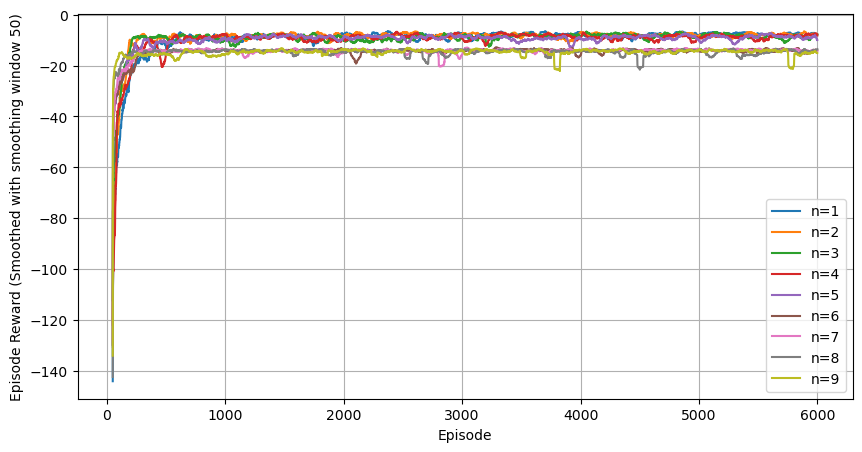

In [38]:
gridsearch_ntd(env, smoothing_window=50)

- By graph inspection, n = 1,2,3,4,5 are the better choice compared to n = 6,7,8,9 because we can see there is gap between two groups in terms of top cumulative reward.
- Specifically, we decided to take n=3 as the it achieves high cumulative rewards in the shorter episodes. 

In [36]:
# Environment Initialization
env = KingWindyGridWorldEnv()
env = CustomRenderWrapper(env) # apply custom rendering
start_time = time.time()

# Hyperparameters
num_episodes = 6000
n_steps = 3 # Define the number of steps for n-step TD
alpha = 0.1
gamma = 0.9

# Training
ntd_policy, Q, king_ntd_train_rewards = td_n_step(env, num_episodes, n_steps, alpha, gamma)
print(f"Total time elapsed: {time.time()-start_time}\n\n")

# Evaluation
policy_location, policy_action = evaluating3(env, ntd_policy)

Episode 6000/6000.Training Complete!

Total time elapsed: 5.524131536483765


# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(4, 1), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(5, 2), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . A . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(6, 3), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . .

In [37]:
# Environment Initialization
policy_env = KingWindyGridWorldEnv()
policy_env = PolicyWrapper(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# 3 . . . . . . G . . # 
# . 3 . . . . . . . . # 
# . . 3 . 3 3 2 . . . # 
# . . . 2 . . . . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion of N-Step Temporal Difference:
#### - N-Step Temporal Difference method (NTD) is faster than Monte Carlo method due to several reasons
####  - NTD do not need to reach terminal state 
####  - NTD take advantage of boostrapping which takes and updates the estimates
#### - NTD is able to get the optimal path to reach terminal state using 7 steps, just like the rest of algorithms.
####
#### Nevertheless, N-Step Temporal Difference is still lower than TD(0) algorithms because it involves with rewards from different timesteps to find value functions.

### Episode Rewards Graph Plotting: KingWindyGridWorld

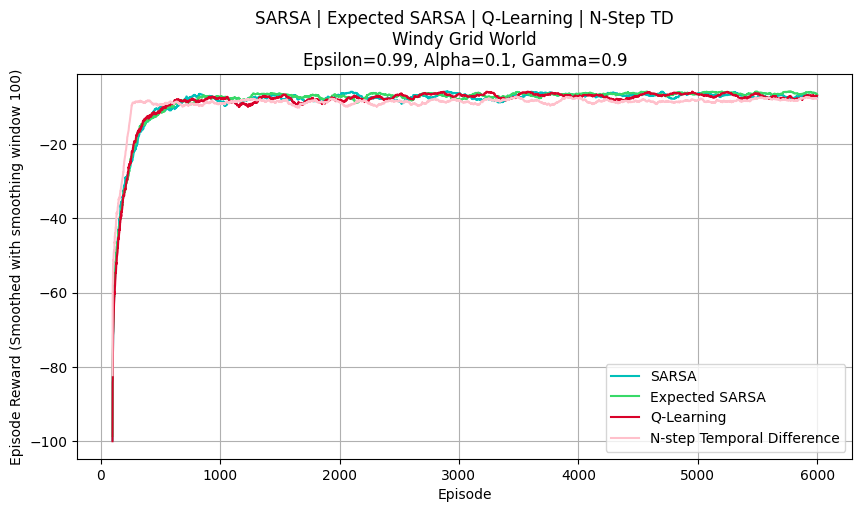

In [38]:
def plot_episode_rewards(ax, rewards, legend_label, color, smoothing_window=10):
    rewards_smoothed = pd.Series(rewards).rolling(smoothing_window, min_periods=smoothing_window).mean()
    ax.plot(rewards_smoothed, label=legend_label, color=color)

smoothing_window = 100

fig, ax = plt.subplots(figsize=(10,5))
ax.set_title(f"SARSA | Expected SARSA | Q-Learning | N-Step TD\nWindy Grid World\nEpsilon={epsilon}, Alpha={alpha}, Gamma={gamma}")
ax.set_xlabel("Episode")
ax.set_ylabel(f"Episode Reward (Smoothed with smoothing window {smoothing_window})")
plot_episode_rewards(ax, king_sarsa_train_rewards, "SARSA", "#00bfb9", smoothing_window)
plot_episode_rewards(ax, king_expsarsa_train_rewards, "Expected SARSA", "#38d968", smoothing_window)
plot_episode_rewards(ax, king_qlearning_train_rewards, "Q-Learning", "#d9022a", smoothing_window)
#plot_episode_rewards(ax, king_mc_train_rewards, "Monte Carlo", "#ffc0cb", smoothing_window)
plot_episode_rewards(ax, king_ntd_train_rewards, "N-step Temporal Difference", "#ffc0cb", smoothing_window)

#ax.set_ylim(bottom=-50)
ax.grid(True)
ax.legend(loc='lower right')
plt.show()

### Discussion:
#### - N-step Temporal Difference will be slightly quicker at reaching optimal reward value point than other algorithms. However, it has the worst performance once episode is about 800.
#### - Expected SARSA has pretty much the same reward earned compared to SARSA and Q-Learning algorihtms. However, it takes way longer time to train when Expected SARSA algorithm.
#### - Q-Learning and SARSA are overall the best algorithm to use in this environment, depends whether your environment focus more on exploration or exploitation.

---
## 2. Stochastic Windy King Environment

#### There's a 33.3% chance that when an agent leaves a windy state, the wind pushing the agent upwards will has its strength increased by 1, decreased by 1 or remained the same.

In [39]:
class StochKingWindyGridWorldEnv(gym.Env):
    '''Creates the Stochastic Windy GridWorld Environment
       NOISE_CASE = 1: the noise is a scalar added to the wind tiles, i.e,
                       all wind tiles are changed by the same amount
       NOISE_CASE = 2: the noise is a vector added to the wind tiles, i.e,
                       wind tiles are changed by different amounts.
    '''
    def __init__(self, GRID_HEIGHT=7, GRID_WIDTH=10, WIND = [0, 0, 0, 1, 1, 1, 2, 2, 1, 0], \
                 START_STATE = (3, 0), GOAL_STATE = (3, 7), REWARD = -1, RANGE_RANDOM_WIND=1,\
                 PROB=[1./3, 1./3, 1./3], NOISE_CASE = 2):
        # Random Wind Seed
        self.seed()
        self.grid_height = GRID_HEIGHT
        self.grid_width = GRID_WIDTH
        # Stochastic Wind
        self.wind = np.array(WIND)
        self.start_state = START_STATE
        self.goal_state = GOAL_STATE
        self.reward = REWARD
        # Range of Wind Strength
        self.range_random_wind = RANGE_RANDOM_WIND
        # Noise case 1 or case 2
        self.probablities = PROB
        self.action_space =  spaces.Discrete(8)
        self.observation_space = spaces.Tuple((
                spaces.Discrete(self.grid_height),
                spaces.Discrete(self.grid_width)))
        self.actions = { 'U':0,   #up
                         'UR':1,   #up-right
                         'R':2,    #right
                         'DR': 3,  #down-right
                         'D':4,   #down
                         'DL':5,  #down-left
                        'L':6,   #left 
                         'UL':7 } #up-left
        # Count Number of Tiles Affected by Wind
        self.num_wind_tiles = np.count_nonzero(self.wind)
        # Set Noise Mode
        self.noise_case = NOISE_CASE
        self.action_space_n = 8
        self.observation_space_n = (self.grid_height*self.grid_width)

    def action_destination(self, state, action):
        '''set up destinations for each action in each state'''
        i, j= state
        rang = np.arange(-self.range_random_wind, self.range_random_wind + 1)
        ##############
        # case 1 where all wind tiles are affected by the same noise scalar,
        # noise1 is a scalar value added to wind
        noise1 = self.np_random.choice(rang, 1, self.probablities)[0]
        # case 2  where each wind tile is affected by a different noise
        # noise2 is a vector added to wind
        noise2 = self.np_random.choice(rang, self.num_wind_tiles, self.probablities)
        noise = noise1 if self.noise_case==1 else noise2
        wind = np.copy(self.wind)
        wind[np.where( wind > 0 )] += noise #only tile that has wind will have noise, tile with no wind wull have no noise
        ##############
        destination = dict()
        destination[self.actions['U']] = (max(i - 1 - wind[j], 0), j)
        destination[self.actions['D']] = (max(min(i + 1 - wind[j], \
                                            self.grid_height - 1), 0), j)
        destination[self.actions['L']] = (max(i - wind[j], 0),\
                                               max(j - 1, 0))
        destination[self.actions['R']] = (max(i - wind[j], 0),\
                                           min(j + 1, self.grid_width - 1))
        destination[self.actions['UR']] = (max(i - 1 - wind[j], 0),\
                                           min(j + 1, self.grid_width - 1))
        destination[self.actions['DR']] = (max(min(i + 1 - wind[j],\
                                           self.grid_height - 1), 0), min(j + 1,\
                                           self.grid_width - 1))
        destination[self.actions['DL']] = (max(min(i + 1 - wind[j],\
                                      self.grid_height - 1), 0), max(j - 1, 0))
        destination[self.actions['UL']] = (max(i - 1 - wind[j], 0),\
                                           max(j - 1, 0))
        return noise, destination[action]

    def step(self, action):
        """
        Parameters
        ----------
        action : 0 = Up, 1 = Up-right, 2 = Right, 3 = Down-right, 4 = Down,
                 5 = Down-left, 6 = Left, 7 = Up-left 
        Returns
        -------
        ob, reward, episode_over, info : tuple
            ob (object) :
                 Agent current position in the grid.
            reward (float) :
                 Reward is -1 at every step.
            episode_over (bool) :
                 True if the agent reaches the goal, False otherwise.
            info (dict) :
                 Contains the realized noise that is added to the wind in each
                 step. However, official evaluations of your agent are not
                 allowed to use this for learning.
        """
        assert self.action_space.contains(action)
        w, self.observation = self.action_destination(self.observation, action)
        if self.observation == self.goal_state:
            return self.observation, 1.0, True, {'w':w}
        return self.observation, -1.0, False, {'w':w}

    def reset(self):
        ''' resets the agent position back to the starting position'''
        self.observation = self.start_state
        return self.observation

    def render(self, mode='human', close=False):
        ''' Renders the environment. Code borrowed and then modified
            from
            https://github.com/openai/gym/blob/master/gym/envs/toy_text/cliffwalking.py'''
        outfile = sys.stdout
        nS = self.grid_height * self.grid_width
        shape = (self.grid_height, self. grid_width)
        outboard = ""
        for y in range(-1, self.grid_height + 1):
            outline = ""
            for x in range(-1, self.grid_width + 1):
                position = (y, x)
                if self.observation == position:
                    output = "X"
                elif position == self.goal_state:
                    output = "G"
                elif position == self.start_state:
                    output = "S"
                elif x in {-1, self.grid_width } or y in {-1, self.grid_height}:
                    output = "#"
                else:
                    output = " "
                if position[1] == shape[1]:
                    output += '\n'
                outline += output
            outboard += outline
        outboard += '\n'
        outfile.write(outboard)

    # Random Seed for Wind
    def seed(self, seed=None):
        ''' sets the seed for the envirnment'''
        self.np_random, seed = seeding.np_random(seed)
        return [seed]
    
    def value_iteration(self, num_iterations=6000):
        # Initialize value function V(s) for all states
        values = np.zeros((self.grid_height, self.grid_width))
        gamma = 0.9  # discount factor

        # Perform value iteration
        for _ in range(num_iterations):  # Define num_iterations as needed
            new_values = np.zeros_like(values)
            for i in range(self.grid_height):
                for j in range(self.grid_width):
                    state = (i, j)
                    if state == self.goal_state:  # Terminal state
                        new_values[state] = 0
                    else:
                        max_value = float('-inf')
                        for action in range(self.action_space_n):
                            # Calculate the expected value for each action
                            noise, next_state = self.action_destination(state, action)
                            reward = -1  # Reward at each step
                            value = reward + gamma * values[next_state]
                            if value > max_value:
                                max_value = value
                        new_values[state] = max_value
            values = new_values

        # Extract optimal policy from the value function
        optimal_policy = np.zeros((self.grid_height, self.grid_width))
        for i in range(self.grid_height):
            for j in range(self.grid_width):
                state = (i, j)
                if state == self.goal_state:
                    optimal_policy[state] = -1  # Terminal state
                else:
                    max_value = float('-inf')
                    best_action = -1
                    for action in range(self.action_space_n):
                        noise, next_state = self.action_destination(state, action)
                        reward = -1
                        value = reward + gamma * values[next_state]
                        if value > max_value:
                            max_value = value
                            best_action = action
                    optimal_policy[state] = best_action

        return values, optimal_policy

### 2.1 Agent -> Random

In [47]:
# Initialization
env = StochKingWindyGridWorldEnv()
env = CustomRenderWrapper(env) # apply custom rendering
env.reset()
done = False
t = 0
total_rewards = 0

while not done:
    action = env.action_space.sample()
    observation, reward, done, info = env.step(action)
    t += 1
    env.render()
    print(f"Info: {info}, Action {action} is taken, Random Agent currently at{observation}, Reward:{reward}\n\n\n")
    total_rewards += reward


print(f"Total steps taken during one episode: {t}")
print(f"Total cumulated rewards: {total_rewards}")
print(f"Total time elapsed: {time.time()-start_time}\n\n")

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  0,  1, -1])}, Action 5 is taken, Random Agent currently at(4, 0), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  0, -1, -1])}, Action 6 is taken, Random Agent currently at(4, 0), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# A . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  0, -1,  0,  1])}, Action 0 is taken, Random Agent currently at(3, 0)

# . . . . . . . . . . # 
# . . A . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1, -1,  0, -1,  0])}, Action 3 is taken, Random Agent currently at(2, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1, -1,  1,  0])}, Action 6 is taken, Random Agent currently at(2, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . A . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  1, -1,  1])}, Action 3 is taken, Random Agent currently at(3, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . . 

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  0, -1,  0,  1])}, Action 7 is taken, Random Agent currently at(1, 0), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  0,  0, -1,  0])}, Action 6 is taken, Random Agent currently at(1, 0), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1,  0,  1, -1])}, Action 3 is taken, Random Agent currently at(2, 1)

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  0,  1,  1])}, Action 4 is taken, Random Agent currently at(1, 8), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . A # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  0, -1, -1, -1])}, Action 3 is taken, Random Agent currently at(2, 9), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1, -1,  1, -1])}, Action 4 is taken, Random Agent currently at(3, 9)

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1,  1, -1,  0])}, Action 1 is taken, Random Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  0,  1, -1])}, Action 7 is taken, Random Agent currently at(0, 1), Reward:-1.0



# # # # # # # # # # # # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1, -1,  0,  1])}, Action 7 is taken, Random Agent currently at(0, 0)

# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1, -1,  0, -1])}, Action 7 is taken, Random Agent currently at(0, 6), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 1, 0, 0, 0, 1])}, Action 7 is taken, Random Agent currently at(0, 5), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1, -1,  0, -1,  0])}, Action 1 is taken, Random Agent currently at(0, 6), Rewa

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1, -1,  0,  1, -1])}, Action 2 is taken, Random Agent currently at(6, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  1,  0,  1])}, Action 6 is taken, Random Agent currently at(6, 0), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  1, -1,  1])}, Action 0 is taken, Random Agent currently at(5, 0)

# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  0,  1, -1])}, Action 1 is taken, Random Agent currently at(0, 9), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  0,  0, -1,  1])}, Action 7 is taken, Random Agent currently at(0, 8), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([1, 1, 1, 1, 0, 1])}, Action 1 is taken, Random Agent currently at(0, 9), Rewa

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1, -1,  0, -1, -1])}, Action 7 is taken, Random Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1,  1,  1,  0])}, Action 4 is taken, Random Agent currently at(1, 2), Reward:-1.0



# # # # # # # # # # # # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1,  0, -1,  1])}, Action 7 is taken, Random Agent currently at(0, 1)

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1, -1,  0,  0])}, Action 4 is taken, Random Agent currently at(1, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1,  0, -1,  0])}, Action 3 is taken, Random Agent currently at(2, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . A . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1,  1,  0,  0])}, Action 3 is taken, Random Agent currently at(3, 3)

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  0,  1, -1,  1])}, Action 4 is taken, Random Agent currently at(0, 7), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1,  0,  0, -1])}, Action 6 is taken, Random Agent currently at(0, 6), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  0, -1, -1])}, Action 6 is taken, Random Agent currently at(0, 5), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . 

# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 0, 0, 1, 1, 1])}, Action 2 is taken, Random Agent currently at(0, 4), Reward:-1.0



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  1, -1,  0, -1])}, Action 4 is taken, Random Agent currently at(0, 4), Reward:-1.0



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1, -1, -1,  0])}, Action 5 is taken, Random Agent currently at(0, 3), Rewa

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1, -1, -1,  0,  1])}, Action 1 is taken, Random Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  0, -1, -1, -1])}, Action 6 is taken, Random Agent currently at(0, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0, -1,  0,  0])}, Action 4 is taken, Random Agent currently at(1, 1)

# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  0,  1,  1, -1])}, Action 3 is taken, Random Agent currently at(0, 8), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1, -1,  1,  0])}, Action 0 is taken, Random Agent currently at(0, 8), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1,  0, -1, -1])}, Action 2 is taken, Random Agent currently at(0, 9)

# # # # # # # # # # # # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1, -1,  1, -1])}, Action 0 is taken, Random Agent currently at(0, 9), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([1, 0, 0, 1, 1, 0])}, Action 5 is taken, Random Agent currently at(1, 8), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . A . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0,  1,  0,  0])}, Action 4 is taken, Random Agent currently at(1, 8), Rewa

# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1,  0,  0,  1])}, Action 6 is taken, Random Agent currently at(0, 5), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1,  1,  1, -1])}, Action 3 is taken, Random Agent currently at(1, 6), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . A . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  1, -1,  0, -1])}, Action 6 is taken, Random Agent currently at(0, 5)

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1,  0, -1, -1])}, Action 0 is taken, Random Agent currently at(1, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1, -1,  0,  0])}, Action 3 is taken, Random Agent currently at(2, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1,  1,  0, -1])}, Action 0 is taken, Random Agent currently at(1, 2)

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  0,  0, -1, -1])}, Action 7 is taken, Random Agent currently at(1, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1,  1, -1, -1])}, Action 6 is taken, Random Agent currently at(1, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  0,  1, -1])}, Action 4 is taken, Random Agent currently at(2, 1)

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . A . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1, -1,  0,  1])}, Action 2 is taken, Random Agent currently at(4, 6), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . A . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  0,  0,  0])}, Action 2 is taken, Random Agent currently at(2, 7), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . A . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0,  0, -1, -1])}, Action 5 is taken, Random Agent currently at(2, 6)

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  0,  1, -1])}, Action 6 is taken, Random Agent currently at(6, 0), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 0, 0, 1, 1, 1])}, Action 0 is taken, Random Agent currently at(5, 0), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1, -1,  1,  1,  0])}, Action 2 is taken, Random Agent currently at(5, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . 

# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  0,  0,  1])}, Action 2 is taken, Random Agent currently at(0, 3), Reward:-1.0



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1, -1, -1,  0])}, Action 1 is taken, Random Agent currently at(0, 4), Reward:-1.0



# # # # # # # # # # # # 
# . . . . A . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0, -1, -1, -1])}, Action 0 is taken, Random Agent currently at(0, 4)

### Conclusion of Random Policy:
#### - Random Agent had taken *3920 steps which means the total reward was *-3918. Apparently, the agent did not learn anything from the random policy due to lack of update rule. We could not find any comparison of random agent in Windy Grid World and Stochastic Windy Grid World. However, we can confirm that, random agent will not having good performance in both environments.
#### - The time taken is apparently longer as the agent have no knowledge to reach the terminal state.

### 2.2 Dynamic Programming
#### Value Iteration / Policy Iteration

In [43]:
env = StochKingWindyGridWorldEnv()  
start_time = time.time()
values, optimal_policy = env.value_iteration(num_iterations=6000)

print("Optimal Values:")
print(values)
print("\nOptimal Policy:")
print(optimal_policy)
print(f"Total time elapsed: {time.time()-start_time}\n\n")

Optimal Values:
[[-5.217031 -5.217031 -4.68559  -5.217031 -5.217031 -5.217031 -5.217031
  -4.0951   -4.0951   -4.0951  ]
 [-5.217031 -5.217031 -4.68559  -4.68559  -5.217031 -4.0951   -5.217031
  -4.0951   -4.0951   -4.0951  ]
 [-5.217031 -4.68559  -4.0951   -4.0951   -4.0951   -1.9      -2.71
  -4.0951   -4.0951   -1.9     ]
 [-5.217031 -4.68559  -4.0951   -4.0951   -2.71     -1.9      -1.
   0.       -1.9      -1.9     ]
 [-5.217031 -4.68559  -4.0951   -3.439    -4.0951   -1.9      -1.
  -1.       -1.       -1.9     ]
 [-5.217031 -4.68559  -4.0951   -3.439    -2.71     -1.9      -1.9
  -1.9      -1.       -1.9     ]
 [-5.217031 -4.68559  -4.0951   -3.439    -2.71     -1.9      -1.
  -1.       -1.9      -2.71    ]]

Optimal Policy:
[[ 0.  1.  0.  5.  3.  4.  1.  0.  0.  0.]
 [ 3.  3.  3.  4.  3.  4.  1.  0.  0.  3.]
 [ 2.  2.  2.  4.  3.  4.  1.  0.  2.  2.]
 [ 1.  1.  3.  4.  2.  3.  4. -1.  1.  5.]
 [ 1.  1.  2.  1.  1.  2.  3.  4.  6.  5.]
 [ 1.  1.  1.  4.  1.  1.  1.  3.  7.  6.]


In [ ]:
optimal_policy_dict = {}

for i in range(len(optimal_policy)):
    for j in range(len(optimal_policy[i])):
        optimal_policy_dict[(i,j)]=int(optimal_policy[i][j])
        
    print('\n')

In [67]:
# Evaluation
env = CustomRenderWrapper(env)
policy_location, policy_action = evaluating3(env, optimal_policy_dict)

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1,  0, -1,  0])},Action 1 was taken, Agent currently at(2, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0, -1,  1, -1])},Action 2 was taken, Agent currently at(2, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . A . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  1,  0, -1])},Action 2 was taken, Agent currently at(2, 3), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1,  1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0,  1,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  0, -1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1, -1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  0, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  0,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  0,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1,  0,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  1,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  0,  1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1, -1,  1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0,  1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1, -1,  1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 0, 0, 1, 1, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1,  1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 0, 0, 0, 1, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  0,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([1, 1, 1, 0, 0, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # 

# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0,  1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  0, -1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1,  0, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([1, 1, 0, 1, 1, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1,  0,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  0,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 0, 1, 0, 0, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  0,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  0, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1, -1, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1, -1,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1,  1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1,  1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([1, 1, 0, 0, 1, 0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1, -1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  0,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  0,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  0,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 1, 1, 0, 1, 0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([1, 0, 0, 1, 1, 0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  0,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1, -1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1, -1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1,  0, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  0,  1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1, -1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([1, 0, 1, 1, 1, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1,  0,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1, -1,  1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0,  0, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1,  1,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1, -1,  1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1, -1,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

Info: {'w': array([ 1,  1,  0, -1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1, -1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1,  0, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1, -1,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([1, 0, 1, 0, 0, 0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1, -1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  0,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  0, -1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  0,  0,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1, -1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1,  1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1,  0,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  0,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1,  0,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1,  1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  0, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 0, 1, 1, 1, 0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 0, 1, 1, 0, 0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1,  1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  0,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1, -1,  1,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1,  1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  0, -1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1, -1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0,  0,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1,  0, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1,  0, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1, -1, -1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . 

# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1, -1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0, -1,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1, -1, -1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1,  0, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1, -1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  0,  1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  0,  1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  0,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1,  1,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0, -1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1, -1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1,  1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1,  0,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  0,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1,  0,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1, -1,  1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  0,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 0, 1, 1, 1, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0,  1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  0, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  0,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  0,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1, -1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0,  1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1,  0,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1, -1,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1, -1,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  0, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([1, 0, 0, 1, 1, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1,  0,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1,  1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 1, 0, 1, 1, 0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1,  1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1,  0,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 1, 0, 1, 0, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1,  1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  0,  0,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1,  0, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  0,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1, -1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  0,  1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1, -1, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1, -1,  1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0, -1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  0,  1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1, -1,  0, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1,  1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  0,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 0, 1, 1, 1, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1,  0,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1, -1,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0, -1,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1, -1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1, -1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  1, -1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1,  1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0, -1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([1, 1, 0, 0, 1, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  0, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1, -1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 1, 0, 0, 0, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1,  1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  0, -1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1, -1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1, -1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1, -1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1,  0,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  0,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  0, -1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1, -1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1, -1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1,  1,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1, -1, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 1, 1, 1, 1, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  0,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0,  0,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  0, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  0, -1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  0,  1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0,  1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  0,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0, -1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1, -1, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1,  1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1, -1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 0, 0, 1, 1, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1, -1,  1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1, -1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0, -1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1, -1, -1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0, -1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  1,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1, -1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1, -1, -1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([1, 1, 0, 1, 0, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1,  0, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1,  0,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  1, -1,  0,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 1, 0, 1, 1, 1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  0,  0,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1,  1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1,  1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1,  1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0,  1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  0,  0,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  0, -1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1,  0,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([0, 0, 0, 0, 1, 0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1,  0,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  0,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1, -1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1,  0,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  1,  0,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1,  1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  0, -1,  0,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1, -1, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  0, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1, -1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  0, -1,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1,  0,  1, -1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1,  1,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  0,  1,  0,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1, -1, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  1,  0, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1,  1,  0, -1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1,  0,  1,  0])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  0,  1, -1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  1,  1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0, -1,  1, -1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0, -1,  1,  1,  1])},Action 0 was taken, Agent currently at(0, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . 

KeyboardInterrupt: 

### Conclusion of Dynamic Programming:
#### - By using value iteration on stochastic king windy grid world, the algorithm seems failed to converge because the agent will keep the same action even facing against the wall. 
#### - Several reasons lead to error:
####   - Insufficient number of iterations
####   - The agent is unable to get used to the random stochastic property of environment. Value iteration is known to not perform well on models that have unknown factors as it does not interact with the current state.

### 2.3 SARSA

In [66]:
# Environment Initialization
env = StochKingWindyGridWorldEnv()
env = CustomRenderWrapper(env) # apply custom rendering
start_time = time.time()

# Hyperparameters
total_episodes = 6000
alpha = 0.1 #learning rate
gamma = 0.9 #associated to reward in value function
epsilon = 0.1 #exploration probability 

# Define Learning Agent
grid_width = 10 # Grid Width is needed to Know which Row of Value Function We are Processing
s_agent = SarsaAgent(epsilon, alpha, gamma, env.observation_space_n, env.action_space_n, env.action_space, grid_width)

# Optimal Policy training
s_agent, sto_king_sarsa_train_rewards = training(env, s_agent, total_episodes)
print(f"Total time elapsed: {time.time()-start_time}\n\n")

# Evaluation
policy_location, policy_action = evaluating(env, s_agent)

Total time elapsed: 17.90302872657776


# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1, -1, -1,  0, -1])},Action 3 was taken, Agent currently at(4, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1,  1, -1,  1])},Action 3 was taken, Agent currently at(5, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . A . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  1, -1, -1,  0,  1])},Action 3 was taken, Agent

In [45]:
# Environment Initialization
policy_env = StochKingWindyGridWorldEnv()
policy_env = PolicyWrapper(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# 3 . . . . . . G . . # 
# . 3 . . . . . 4 . . # 
# . . 3 . . 3 . . . . # 
# . . . 2 3 . 1 . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion of SARSA:
#### - SARSA agent took 17.90 seconds to complete 6000 episodes.
#### - SARSA agent is able to reach terminal state with minimal steps of 8 even though there is unpredictable wind around the environment. 
#### - The cumulative rewards during one evaluation episodes is normally -6. Howrver, the SARSA agent sometimes unable to achieve maximum cumulative reward of -5 due to the stochastic property of environment.

### 2.4 Expected SARSA

In [46]:
# Environment Initialization
env = StochKingWindyGridWorldEnv()
env = CustomRenderWrapper(env) # apply custom rendering
start_time = time.time()

# Same hyperparameter
total_episodes = 6000
alpha = 0.1
gamma = 0.9
epsilon = 0.1 #exploration probability

# Define Learning Agent
grid_width = 10
es_agent = ExpectedSarsaAgent(epsilon, alpha, gamma, env.observation_space_n, env.action_space_n, env.action_space, grid_width)

# Optimal Policy training
es_agent, sto_king_expsarsa_train_rewards = training(env, es_agent, total_episodes)
print(f"Total time elapsed: {time.time()-start_time}\n\n")

## Evaluation
policy_location, policy_action = evaluating(env, es_agent)

Total time elapsed: 22.868589162826538


# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  0, -1,  1,  1])},Action 3 was taken, Agent currently at(4, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0,  1,  0, -1,  0])},Action 3 was taken, Agent currently at(5, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . A . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1,  0, -1, -1,  1,  1])},Action 3 was taken, Agen

In [47]:
# Environment Initialization
policy_env = StochKingWindyGridWorldEnv()
policy_env = PolicyWrapper(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# 3 . . . . . . G . . # 
# . 3 . . . . . . . . # 
# . . 3 . . . 3 4 . . # 
# . . . 3 3 3 . . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion of Expected SARSA:
#### - Expected SARSA agent took 22.87 seconds to complete training, which is slower than SARSA. This is likely due to calculation of probabilities and expected values. 
#### - Expected SARSA agent is able to reach terminal state with minimal steps of 8. 
#### - The maximum cumulative rewards during one evaluation episodes is -6. 
#### - The final outcome is uncertain due to the stochasticity of the environment.

### 2.5 Q-Learning

In [50]:
# Environment Initialization
env = StochKingWindyGridWorldEnv()
env = CustomRenderWrapper(env) # apply custom rendering
start_time = time.time()

# Same hyperparameter
total_episodes = 6000
alpha = 0.1
gamma = 0.9
epsilon = 0.1 #exploration probability

# Define Learning Agent
grid_width = 10
q_agent = QLearningAgent(epsilon, alpha, gamma, env.observation_space_n, env.action_space_n, env.action_space, grid_width)

# Optimal Policy training
q_agent, sto_king_ql_train_rewards = training(env, q_agent, total_episodes)
print(f"Total time elapsed: {time.time()-start_time}\n\n")

## Evaluation
policy_location, policy_action = evaluating(env, q_agent)

Total time elapsed: 20.647721529006958


# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1, -1, -1,  1,  1, -1])},Action 3 was taken, Agent currently at(4, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  0,  1,  0,  0,  1])},Action 3 was taken, Agent currently at(5, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1, -1,  0, -1,  1])},Action 2 was taken, Agen

In [51]:
# Environment Initialization
policy_env = StochKingWindyGridWorldEnv()
policy_env = PolicyWrapper(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# 3 . . . . . . G . . # 
# . 3 . . . . . 4 . . # 
# . . 2 3 . 3 3 . . . # 
# . . . . 2 . . . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion of Q-Learning:
#### - Q-Learning agent needed approximately 20 seconds to finish training which appears to be slower than SARSA but faster than Expected SARSA. This is likely due to Q-Learning algorithm is better at exploring unknown states and find any potential hidden policy that is more efficient. Q-Learning simply handles the randomness in this environment better than the algorithms. However, Q-Learning will take additional time to explore new possible policies.
#### - Q-Learning agent is able to reach terminal state with minimal steps of 8. 
#### - The cumulative rewards during one evaluation episodes is -6.
#### - The stochasticity will sometimes alter the performance of the agents.

### 2.6 Monte-Carlo

In [52]:
from collections import defaultdict

# Environment Initialization
env = StochKingWindyGridWorldEnv()
env = CustomRenderWrapper(env) # apply custom rendering

# Same hyperparameter
total_episodes = 6000
alpha = 0.02
gamma = 0.9
epsilon = 0.99 #exploration probability

def generate_episode_from_Q(env, Q, epsilon, nA):
    """ generates an episode from following the epsilon-greedy policy """
    episode = []
    rewards = []
    state = env.reset()
    while True:
        action = np.random.choice(np.arange(nA), p=get_probs(Q[state], epsilon, nA)) \
                                    if state in Q else env.action_space.sample()
        next_state, reward, done, info = env.step(action)
        episode.append((state, action, reward))
        rewards.append(reward)
        state = next_state
        if done:
            break
    return episode,rewards

def get_probs(Q_s, epsilon, nA):
    """ obtains the action probabilities corresponding to epsilon-greedy policy """
    policy_s = np.ones(nA) * epsilon / nA
    best_a = np.argmax(Q_s)
    policy_s[best_a] = 1 - epsilon + (epsilon / nA)
    return policy_s

def update_Q(env, episode, Q, alpha, gamma):
    """ updates the action-value function estimate using the most recent episode """
    states, actions, rewards = zip(*episode)
    # prepare for discounting
    discounts = np.array([gamma**i for i in range(len(rewards)+1)])
    for i, state in enumerate(states):
        old_Q = Q[state][actions[i]]
        Q[state][actions[i]] = old_Q + alpha*(sum(rewards[i:]*discounts[:-(1+i)]) - old_Q)
    return Q

def mc_control(env, num_episodes, alpha, gamma=1.0, eps_start=1.0, eps_decay=.99, eps_min=0.05):
    nA = env.action_space_n
    # initialize empty dictionary of arrays
    Q = defaultdict(lambda: np.random.rand(nA))
    epsilon = eps_start
    # loop over episodes
    for i_episode in range(1, num_episodes+1):
        # monitor progress
        if i_episode % 10 == 0:
            print("\rEpisode {}/{}.".format(i_episode, num_episodes), end="")
            sys.stdout.flush()
        # set the value of epsilon
        epsilon = max(epsilon*eps_decay, eps_min)
        # decrease alpha over time
        alpha = max(alpha*0.99, 0.01)
        # generate an episode by following epsilon-greedy policy
        episode, rewards = generate_episode_from_Q(env, Q, epsilon, nA)
        # update the action-value function estimate using the episode
        Q = update_Q(env, episode, Q, alpha, gamma)

    # determine the policy corresponding to the final action-value function estimate
    policy = dict((k,np.argmax(v)) for k, v in Q.items())
    return policy, Q, rewards

In [53]:
start_time = time.time()

# obtain the estimated optimal policy and action-value function
mc_agent_policy, mc_Q, sto_king_mc_train_rewards = mc_control(env, total_episodes, alpha)
print(f"Total time elapsed: {time.time()-start_time}\n\n")

Episode 6000/6000.Total time elapsed: 60.761736154556274




In [54]:
# Evaluation 
#alpha: 0.02, gamma: 0.9
policy_location, policy_action = evaluating3(env, mc_agent_policy)

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S A . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 1, -1,  0,  1,  1, -1])},Action 2 was taken, Agent currently at(3, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1,  1,  1,  0,  1])},Action 3 was taken, Agent currently at(4, 2), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . A . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([-1,  1, -1, -1,  0,  1])},Action 1 was taken, Agent currently at(3, 3), Reward:-1.0



# # 

In [55]:
# Environment Initialization
policy_env = KingWindyGridWorldEnv()
policy_env = PolicyWrapper(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . . . . 1 1 2 3 3 3 3 3 3 3 3 3 3 3 3 3 3 5 5 5 5 5 5 # 
# . . . . . . . . 7 7 7 7 7 7 4 # 
# . . . . . . . . . 4 # 
# 2 3 . 3 0 6 . G . 5 # 
# . . 1 . 2 . . . 5 . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion of Monte Carlo:
#### - Monte Carlo method took 60 seconds which is the slowest method to solve this environment among all methods.
#### - With the settings to reach terminal state, MC will need further computations.
#### - Besides, probably due to insufficient episodes, MC do not converge immediately and keep going through same states. 

### 2.6 Agent: N-Step Temporal Difference

Grid search for n = 1
Episode 6000/6000.Training Complete!

Grid search for n = 2
Episode 6000/6000.Training Complete!

Grid search for n = 3
Episode 6000/6000.Training Complete!

Grid search for n = 4
Episode 6000/6000.Training Complete!

Grid search for n = 5
Episode 6000/6000.Training Complete!

Grid search for n = 6
Episode 6000/6000.Training Complete!

Grid search for n = 7
Episode 6000/6000.Training Complete!

Grid search for n = 8
Episode 6000/6000.Training Complete!

Grid search for n = 9
Episode 6000/6000.Training Complete!



<Figure size 1000x600 with 0 Axes>

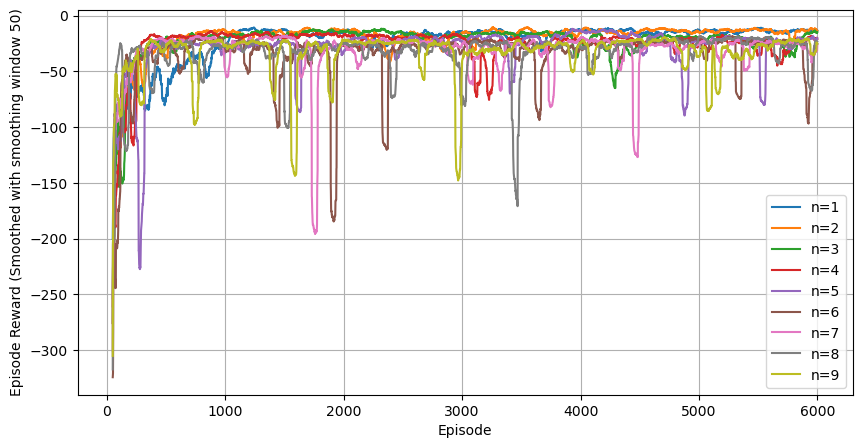

In [98]:
gridsearch_ntd(env, smoothing_window=50)

#### - Through graph inspection, the differences between each lines graph are subtle.
#### - Specifically, we decided to take n=3 as it is more consistent in hitting the highest cumulative rewards during episodes.

In [56]:
# Same hyperparameter
total_episodes = 6000
alpha = 0.1
gamma = 0.9
epsilon = 0.1 #exploration probability
n = 3 #Take the optimal by inspecting graph
start_time = time.time()

# obtain the estimated optimal policy and action-value function
sto_ntd_policy, sto_ntd_Q, sto_king_ntd_train_rewards = td_n_step(env, total_episodes, n=n, alpha=alpha)
print(f"Total time elapsed: {time.time()-start_time}\n\n")

# Evaluation
policy_location, policy_action = evaluating3(env, sto_ntd_policy)

Episode 6000/6000.Training Complete!

Total time elapsed: 31.87446665763855


# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0, -1,  1,  0,  1, -1])},Action 4 was taken, Agent currently at(4, 0), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0,  1,  0,  1, -1])},Action 3 was taken, Agent currently at(5, 1), Reward:-1.0



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . . # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Info: {'w': array([ 0,  0, -1, -

### Conclusion of N-Step Temporal Difference:
#### - NTD took 31.87 seconds which is always shorter time compared to Monte Carlo method.
#### - With aid of bootstrapping, even in stochastic environment, NTD is able produce good results.
#### - In one time, NTD with n=3 achieve nearly optimal result with total cumulative rewards of -6.

### Episode Rewards Graph Plotting 2.StochasticKingWindyGrid World

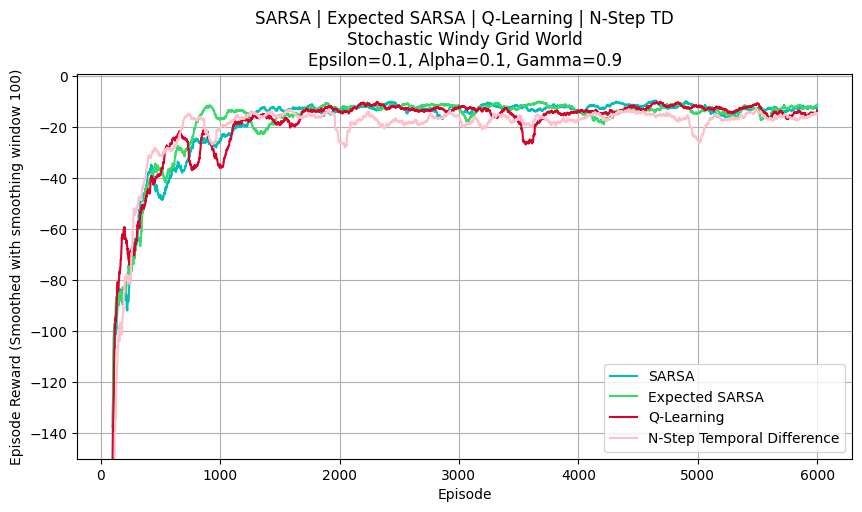

In [57]:
def plot_episode_rewards(ax, rewards, legend_label, color, smoothing_window=10):
    rewards_smoothed = pd.Series(rewards).rolling(smoothing_window, min_periods=smoothing_window).mean()
    ax.plot(rewards_smoothed, label=legend_label, color=color)

smoothing_window = 100

fig, ax = plt.subplots(figsize=(10,5))
ax.set_title(f"SARSA | Expected SARSA | Q-Learning | N-Step TD\nStochastic Windy Grid World\nEpsilon={epsilon}, Alpha={alpha}, Gamma={gamma}")
ax.set_xlabel("Episode")
ax.set_ylabel(f"Episode Reward (Smoothed with smoothing window {smoothing_window})")
plot_episode_rewards(ax, sto_king_sarsa_train_rewards, "SARSA", "#00bfb9", smoothing_window)
plot_episode_rewards(ax, sto_king_expsarsa_train_rewards, "Expected SARSA", "#38d968", smoothing_window)
plot_episode_rewards(ax, sto_king_ql_train_rewards, "Q-Learning", "#d9022a", smoothing_window)
#plot_episode_rewards(ax, sto_king_mc_train_rewards, "Monte Carlo", "#d9022a", smoothing_window)
plot_episode_rewards(ax, sto_king_ntd_train_rewards, "N-Step Temporal Difference", "#ffc0cb", smoothing_window)

ax.set_ylim(bottom=-150)
ax.grid(True)
ax.legend(loc='lower right')
plt.show()

### Discussion:
#### - N-step Temporal Difference has the worst performance overall.
#### Q-Learning suprisingly sometimes has worse performance than N-step Temporal Difference. One possible reason is that Q-Learning is trying to explore unexplored states for new policies when it has bad performance.
#### - Expected SARSA and SARSA are overall the best algorithm to use in this environment.

---
## 3. Trappy Windy Grid World

#### This environment introduces a trap state (env.boom). If an agent moves onto a trap state in an episode, this episode will be instantly come to end and the reward will be always -99.

In [58]:
class TrappyWindyGridWorldEnv(gym.Env):
    def __init__(self, GRID_HEIGHT=7, GRID_WIDTH=10, WIND = [0, 0, 0, 1, 1, 1, 2, 2, 1, 0], \
                 START_STATE = (3, 0), GOAL_STATE = (3, 7), REWARD = -1):
        self.grid_height = GRID_HEIGHT
        self.grid_width = GRID_WIDTH
        self.wind = WIND
        self.victim_start_state = START_STATE
        self.victim_goal_state = GOAL_STATE
        self.victim_observation = START_STATE
        self.victim_reward = REWARD

        self.action_space =  spaces.Discrete(8)
        self.observation_space = spaces.Tuple((
                spaces.Discrete(self.grid_height),
                spaces.Discrete(self.grid_width)))
        self.observation_space_n = self.grid_width*self.grid_height
        self.action_space_n = 8
        self.actions = {'U':0,   #up
                         'UR':1,   #up-right
                         'R':2,    #right
                         'DR': 3,  #down-right
                         'D':4,   #down
                         'DL':5,  #down-left
                        'L':6,   #left 
                         'UL':7 } #up-left
        # set up destinations for each action in each state
        self.action_destination = np.empty((self.grid_height,self.grid_width), dtype=dict)
        for i in range(0, self.grid_height):
            for j in range(0, self.grid_width):
                destination = dict()
                destination[self.actions['U']] = (max(i - 1 - self.wind[j], 0), j)
                destination[self.actions['D']] = (max(min(i + 1 - self.wind[j], \
                                                    self.grid_height - 1), 0), j)
                destination[self.actions['L']] = (max(i - self.wind[j], 0),\
                                                       max(j - 1, 0))
                destination[self.actions['R']] = (max(i - self.wind[j], 0),\
                                                   min(j + 1, self.grid_width - 1))
                destination[self.actions['UR']] = (max(i - 1 - self.wind[j], 0),\
                                                   min(j + 1, self.grid_width - 1))
                destination[self.actions['DR']] = (max(min(i + 1 - self.wind[j],\
                                                   self.grid_height - 1), 0), min(j + 1,\
                                                   self.grid_width - 1))
                destination[self.actions['DL']] = (max(min(i + 1 - self.wind[j],\
                                              self.grid_height - 1), 0), max(j - 1, 0))
                destination[self.actions['UL']] = (max(i - 1 - self.wind[j], 0),\
                                                   max(j - 1, 0))
                self.action_destination[i,j]=destination


    def step(self, action):
        assert self.action_space.contains(action)
        self.victim_observation = self.action_destination[self.victim_observation][action]
        if self.victim_observation == self.victim_goal_state:
            return self.victim_observation, 1, True, {}, True
        elif self.boom and self.victim_observation in self.boom: 
            return self.victim_observation, -99, True, {}, False
        return self.victim_observation, -1, False, {}, False


    def reset(self):
        ''' resets the agent position back to the starting position'''
        self.victim_observation = self.victim_start_state
        return self.victim_observation

    def render(self, mode='human', close=False):
        ''' Renders the environment. Code borrowed and then modified
            from
            https://github.com/openai/gym/blob/master/gym/envs/toy_text/cliffwalking.py'''
        outfile = sys.stdout
        nS = self.grid_height * self.grid_width
        shape = (self.grid_height, self. grid_width)

        outboard = ""
        for y in range(-1, self.grid_height + 1):
            outline = ""
            for x in range(-1, self.grid_width + 1):
                position = (y, x)
                if self.victim_observation == position:
                    output = "V"
                # Display Traps
                elif position in self.boom:
                    output = "@"
                elif position == self.victim_goal_state:
                    output = "G"
                elif position == self.victim_start_state:
                    output = "S"
                elif x in {-1, self.grid_width } or y in {-1, self.grid_height}:
                    output = "#"
                else:
                    output = " "

                if position[1] == shape[1]:
                    output += '\n'
                outline += output
            outboard += outline
        outboard += '\n'
        outfile.write(outboard)

    # Lay Traps Randomly num_trap = maximum trap present
    def BOOM(self, trap_, num_trap = 2, randomize = 1):
        if randomize ==1:
            trap_ = []
            count_trap = 0

            while True:
                # Done Laying Traps
                if count_trap == num_trap:
                    break
                # Random Assign Trap Location
                t1 = (random.randint(0, self.grid_height-1), random.randint(0, self.grid_width-1))
                # Trap must never appear in Starting or Goal State
                if t1 != self.victim_start_state and t1 != self.victim_goal_state:
                    trap_.append(t1)
                    count_trap += 1
                else:
                    continue
            self.boom = trap_
            
            return trap_
        
        else:
            self.boom = trap_
            return trap_

    def seed(self, seed=None):
        pass
    
    def value_iteration(self, num_iterations=100):
        # Initialize value function V(s) for all states
        values = np.zeros((self.grid_height, self.grid_width))
        gamma = 0.9  # discount factor

        # Perform value iteration
        for _ in range(num_iterations):  
            new_values = np.zeros_like(values)
            for i in range(self.grid_height):
                for j in range(self.grid_width):
                    state = (i, j)
                    if state == self.victim_goal_state:  # Terminal state
                        new_values[state] = 0
                    elif state in self.boom:  # Traps
                        new_values[state] = -99  # Penalty for traps
                    else:
                        max_value = float('-inf')
                        for action in range(self.action_space_n):
                            # Use indexing to access action_destination
                            next_state = self.action_destination[state][action]
                            reward = -1  # Reward at each step
                            value = reward + gamma * values[next_state]
                            if value > max_value:
                                max_value = value
                        new_values[state] = max_value
            values = new_values

        # Extract optimal policy from the value function
        optimal_policy = np.zeros((self.grid_height, self.grid_width))
        for i in range(self.grid_height):
            for j in range(self.grid_width):
                state = (i, j)
                if state == self.victim_goal_state:
                    optimal_policy[state] = -1  # Terminal state
                elif state in self.boom:
                    optimal_policy[state] = -99  # Traps
                else:
                    max_value = float('-inf')
                    best_action = -1
                    for action in range(self.action_space_n):
                        # Use indexing to access action_destination
                        next_state = self.action_destination[state][action]
                        reward = -1
                        value = reward + gamma * values[next_state]
                        if value > max_value:
                            max_value = value
                            best_action = action
                    optimal_policy[state] = best_action

        return values, optimal_policy

### 3.1 Agent -> Random

In [60]:
# Initialization
env = TrappyWindyGridWorldEnv()
env = CustomRenderWrapper2(env) # apply custom rendering
trap_ = []
trap_ = env.BOOM(trap_, num_trap = 5) #setting traps number
env.reset()
done = False
t = 0
win = 0 #counting agent's survival
death = 0 #counting agent's death
total_rewards = 0

# Agent will revive
while not win:
    done = False
    print(f"\n###Game{death+1}###\n")
    while not done:
        action = env.action_space.sample()
        observation, reward, done, info, win = env.step(action)
        t += 1
        env.render()
        print(f"Action {action} is taken, Agent currently at{observation}, Reward:{reward}\n\n\n")
        total_rewards += reward
        # info = Noise, note that it only applies to windy areas
    if not win:
        for _ in range(20):
            print("BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM")
        death += 1

print(f"Total steps taken for the whole game: {t}")
print(f"Total cumulated rewards: {total_rewards}")
print(f"Agent had died for {death} times!")


###Game1###

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . @ . . . . . # 
# . . . @ . . . . . . # 
# S @ . . . . . G . . # 
# A . . . . . . . . . # 
# . . . . . . . . . @ # 
# . . . . . @ . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(4, 0), Reward:-1



# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . @ . . . . . # 
# . . . @ . . . . . . # 
# S A . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . @ # 
# . . . . . @ . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(3, 1), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BO

# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . A @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . A . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 6), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
B

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(2, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . A . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(1, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . 

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Age

# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . A . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . A . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . A . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 8), Reward:-1



# # # # # # # 

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 6), Re

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(3, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . A . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(3, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . A . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(4, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . A . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(3, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOO

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . A # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Age

BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game32###

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . A . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(1, 1), Reward:-1



#

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # 

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . A . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . A . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(2, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . A . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(1, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . A . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . A . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . A # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(1, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . 

# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . 

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(6, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# A . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(6, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(5, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . @ # 
# . . . . . . . . . . #

# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(1, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . A # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(1, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . A # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . 

# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 5), Re

# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . A . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 0), Re

# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game61###

# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 


# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Age

# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . #

# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(1, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . A # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(2, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . A # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(1, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . A . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # 

# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game80###



# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . 

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Age

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# A . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(3, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . @ #

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Age

# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . #

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BO

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 8), Re

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Re

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 6), Re

# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . 

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 6), Re

# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(3, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ A . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(2, 3), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . A . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(1, 2), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . 

# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . A . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-B

# S . . . . . . G . . # 
# . A . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(4, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(4, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(5, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Age

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# A . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(3, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S A . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(3, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . 

# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(5, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(5, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(4, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(5, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . A . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(1, 2), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BO

# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game167###


# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BO

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-B

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . A . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(3, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ A . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(2, 2), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-B

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # 

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # #

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(1, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # #

# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BO

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ A . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(2, 2), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-B

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-B

# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# A . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . A . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ A . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 2), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOO

# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-B

BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game232###

# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . A . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, 

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . A . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . A . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(1, 2), Re

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# A . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Age

# . @ @ . . . @ . . . # 
# S . A . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(3, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ A . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(2, 2), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-B

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 6), Re

# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . 

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 7), Re

# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(1, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . A . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . A # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . A . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(2, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . A . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . A # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(1, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . A # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 9), Reward:-1



# # # # # # # 

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . A . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 9), Re

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game255###

# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 

# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . 

# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BO

# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 1), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game273###

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . A . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 4), Re

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(1, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . A @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 1), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-B

# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . A . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(4, 3), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ A . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(2, 2), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-B

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . 

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Age

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game304###

# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 

# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # 

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Age

# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ A . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(2, 3), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ A . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(2, 3), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ A . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 2), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BO

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . 

BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game323###

# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

# S . . . . A . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(3, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . A . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(1, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Age

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game336###

# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 

# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . 

# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . #

# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # 

# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game350###


# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 1), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game357###

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . A . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # 

# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . A # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Age

# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . #

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 6), Re

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 7), Re

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . A . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ A . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # #

# . . . @ . . . . . . # 
# . . . A . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(1, 3), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . A . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(1, 3), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(3, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . A . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(4, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# A . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(5, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(5, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . 

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(3, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(4, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(5, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(4, 0), Re

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # #

# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BO

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 7), Re

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game390###

# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game394###

# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 8), Re

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S A . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(3, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . A . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # #

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(3, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . A @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(2, 1), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-B

# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . A . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(1, 2), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BO

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(1, 3), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . A . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 2), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Age

# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . 

# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(2, 2), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game425###

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . A . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . 

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # #

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 3), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ A . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(2, 3), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . A . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(1, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # 

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Age

# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BO

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # 

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 3), Re

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . A @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 1), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BO

# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . A @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 1), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
B

# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(4, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . A . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(4, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . A . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(5, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . A . . . . . . #

# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game497###

# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 

# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BO

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Age

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game513###

# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Age

# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(3, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S A . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(3, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# A . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(4, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S A . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(3, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . 

# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . 

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(2, 1), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game532###

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . A . . . . . . . # 
# . @ @ . . . @ . . . # 

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(2, 2), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM

###Game537###

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . A @ . . . @ . . . # 

# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . A . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(1, 3), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BO

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # #

# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . #

# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . A # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(1, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . A # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-B

# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(2, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# A . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(3, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # #

# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # 

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . A . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# A @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Age

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . A . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(1, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . A @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(2, 1), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BO

# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . #

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # 

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 9), Re

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(1, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . A # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . A # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(2, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . A # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # #

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 8), Re

# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(2, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . A # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(3, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . A @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(4, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . A # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Age

# . . . @ . . . . . . # 
# . . A . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(1, 2), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . A . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 6), Re

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BO

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-B

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # # # # # # 
# . . . @ . A . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 5), Reward:-1



# # # # # # # # # # # # 
# . . . @ A . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 4), Reward:-1



# # # # # # # 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . A . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 5 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# A . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(1, 0), Reward:-1



# # # # # # # # # # # # 
# A . . @ . . 

# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(1, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . A # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(1, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . 

# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Age

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # 

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # 

# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(5, 2), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . A . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(5, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(6, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . A . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(6, 1), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . 

# . . A @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 2), Reward:-1



# # # # # # # # # # # # 
# . . . A . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 3), Reward:-99



BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
BOOM-BOOM-BOOM-BOOM-BOOM-BOOM-BOOM
B

# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ #

# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(0, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . A # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # #

# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . A . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 7 is taken, Agent currently at(0, 6), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . A . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 0 is taken, Agent currently at(0, 7), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . A . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 is taken, Agent currently at(0, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . A # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . #

# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 4 is taken, Agent currently at(2, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . A . # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 6 is taken, Agent currently at(2, 8), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . A # 
# S . . . . . . G . . # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(2, 9), Reward:-1



# # # # # # # # # # # # 
# . . . @ . . . . . . # 
# . . . . . . . . . . # 
# . @ @ . . . @ . . . # 
# S . . . . . . G . A # 
# . . . . . . . . . @ # 
# . . . . . . . . . . # 
# . . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 is taken, Agent currently at(3, 9), Reward:-1



# # # # # # # 

### Conclusion:
#### As always, random agent has the worst performance among the agents. It takes 6929 steps and 632 deaths for the agent to successfully move to the goal state.

### 3.2 Policy / Value Iteration ### 

In [60]:
env = TrappyWindyGridWorldEnv() 
env.BOOM(trap_,num_trap=5, randomize = 0)  # Lay traps that is already setted up
start_time = time.time()
values, optimal_policy = env.value_iteration()


print("Optimal Values:")
print(values)
print("\nOptimal Policy:")
print(optimal_policy)
print(f"Total time elapsed: {time.time()-start_time}")

Optimal Values:
[[ -5.6953279  -99.          -5.6953279   -6.12579511  -6.12579511
   -5.6953279   -5.217031    -4.68559     -4.0951      -3.439     ]
 [ -5.217031    -5.217031   -99.          -6.12579511  -6.12579511
   -5.6953279   -5.217031    -4.68559     -3.439       -2.71      ]
 [ -5.217031    -4.68559     -4.68559     -5.217031    -5.6953279
   -5.6953279   -5.217031    -4.0951      -2.71        -1.9       ]
 [ -5.217031    -4.68559     -4.0951      -4.68559     -5.217031
   -5.217031    -4.68559      0.          -1.          -1.9       ]
 [ -5.217031    -4.68559     -4.0951      -3.439       -2.71
   -1.9         -1.          -1.         -99.          -1.9       ]
 [ -5.217031    -4.68559     -4.0951      -3.439       -2.71
   -1.9         -1.          -1.9        -99.          -2.71      ]
 [-99.          -4.68559     -4.0951      -3.439       -2.71
   -1.9         -1.          -1.          -1.9         -2.71      ]]

Optimal Policy:
[[  3. -99.   5.   5.   1.   1.   1.   1. 

In [61]:
optimal_policy_dict = {}

for i in range(len(optimal_policy)):
    for j in range(len(optimal_policy[i])):
        optimal_policy_dict[(i,j)]=int(optimal_policy[i][j])
        
    print('\n')

In [62]:
# Evaluation
env = CustomRenderWrapper2(env)
boom_loc = env.boom
policy_location, policy_action = evaluating4(env, optimal_policy_dict,boom_loc)

# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . A . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . @ . # 
# . . . . . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Agent currently at(2, 1), Reward:-1



# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . A . . . . G . . # 
# . . . . . . . . @ . # 
# . . . . . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(3, 2), Reward:-1



# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . A . . . . @ . # 
# . . . . . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(4, 3), Reward:-1



# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . A . . . @ 

In [63]:
# Environment Initialization
policy_env = TrappyWindyGridWorldEnv()
policy_env = PolicyWrapper2(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . 3 . . . . . . . . # 
# 1 . 3 . . . . G . . # 
# . . . 3 3 3 3 . @ . # 
# . . . . . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion:
#### - As always, value iteration takes very few amount of tume (only 0.046 seconds) to train. This is due to the Trappy Windy Grid World being just as simple as Normal Windy Grid World, but with a few additional trap states.
#### - Despite the presence of traps, value iteration still only takes 7 time steps (and reward of -5) to finish its evaluation.

### 3.3 SARSA

In [64]:
# Initialization
env = TrappyWindyGridWorldEnv()
env = CustomRenderWrapper2(env) # apply custom rendering
env.BOOM(trap_, num_trap = 5, randomize = 0) #use the same traps
env.reset()
done = False
t = 0
win = 0 #counting agent's survival
death = 0 #counting agent's death
total_rewards = 0
start_time = time.time()

# Hyperparameters
total_episodes = 6000
alpha = 0.1
gamma = 0.9
epsilon = 0.1
epsilon_decay = 0.999

# Define Learning Agent
grid_width = 10
s_agent = SarsaAgent(epsilon, alpha, gamma, env.observation_space_n, env.action_space_n, env.action_space, grid_width)

# Optimal Policy training
s_agent, trap_king_sarsa_train_rewards, boom_loc = training2(env, s_agent, total_episodes)
print(f"Total time elapsed: {time.time()-start_time}")

## Evaluation
policy_location, policy_action = evaluating2(env, s_agent, boom_loc)

Total time elapsed: 1.308966875076294
# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S A . . . . . G . . # 
# . . . . . . . . @ . # 
# . . . . . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Agent currently at(3, 1), Reward:-1



# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . A . . . . . @ . # 
# . . . . . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(4, 2), Reward:-1



# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . @ . # 
# . . . A . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(5, 3), Reward:-1



# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . .

In [65]:
# Environment Initialization
policy_env = TrappyWindyGridWorldEnv()
policy_env = PolicyWrapper2(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# 2 3 . . . . . G . . # 
# . . 3 . . . . . @ . # 
# . . . 3 3 3 2 . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion:
#### - The time taken for SARSA (1.31s) to complete training is pretty short, but longer than value iteration.
#### - SARSA still evaluates the best possible reward (-5) with least amount of time steps (7) possible.

### 3.4 Expected SARSA

In [67]:
# Initialization
env = TrappyWindyGridWorldEnv()
env = CustomRenderWrapper2(env) # apply custom rendering
env.BOOM(trap_, num_trap = 5, randomize = 0) #use the same traps
env.reset()
done = False
t = 0
win = 0 #counting agent's survival
death = 0 #counting agent's death
total_rewards = 0
start_time = time.time()

# Hyperparameters
total_episodes = 6000
alpha = 0.1
gamma = 0.9
epsilon = 0.1
epsilon_decay = 0.999

# Define Learning Agent
grid_width = 10
es_agent = ExpectedSarsaAgent(epsilon, alpha, gamma, env.observation_space_n, env.action_space_n, env.action_space, grid_width)

# Optimal Policy training
start_time = time.time()
es_agent, trap_king_expsarsa_train_rewards, boom_loc = training2(env, es_agent, total_episodes)
print(f"Total time elapsed: {time.time()-start_time}")

## Evaluation
policy_location, policy_action = evaluating2(env, es_agent, boom_loc)

Total time elapsed: 3.0999433994293213
# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . A . . . . . . @ . # 
# . . . . . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(4, 1), Reward:-1



# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . @ . # 
# . . A . . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(5, 2), Reward:-1



# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . . . . . . @ . # 
# . . . . . . . . @ . # 
# @ . . A . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(6, 3), Reward:-1



# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . 

In [68]:
# Environment Initialization
policy_env = TrappyWindyGridWorldEnv()
policy_env = PolicyWrapper2(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# 3 . . . . . . G . . # 
# . 3 . . . . 3 . @ . # 
# . . 3 . . . . . @ . # 
# @ . . 3 3 1 . . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion:
#### - The time taken for Expected SARSA (3.10s) to complete training is longer than value iteration.
#### - Expected SARSA still evaluates the best possible reward (-5) with least amount of time steps (7) possible.

### 3.5 Q-Learning

In [69]:
# Initialization
env = TrappyWindyGridWorldEnv()
env = CustomRenderWrapper2(env) # apply custom rendering
env.BOOM(trap_, num_trap = 5, randomize = 0) #use the same traps
env.reset()
done = False
t = 0
win = 0 #counting agent's survival
death = 0 #counting agent's death
total_rewards = 0
start_time = time.time()

# Hyperparameters
total_episodes = 6000
alpha = 0.1
gamma = 0.9
epsilon = 0.1
epsilon_decay = 0.999

# Define Learning Agent
grid_width = 10
q_agent = QLearningAgent(epsilon, alpha, gamma, env.observation_space_n, env.action_space_n, env.action_space, grid_width)

# Optimal Policy training
q_agent, trap_king_ql_train_rewards, boom_loc = training2(env, q_agent, total_episodes)
print(f"Total time elapsed: {time.time()-start_time}")

## Evaluation
policy_location, policy_action = evaluating2(env, q_agent, boom_loc)

Total time elapsed: 1.761857271194458
# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . A . . . . . . @ . # 
# . . . . . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(4, 1), Reward:-1



# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . A . . . . G . . # 
# . . . . . . . . @ . # 
# . . . . . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

Action 1 was taken, Agent currently at(3, 2), Reward:-1



# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . . . . . . G . . # 
# . . . A . . . . @ . # 
# . . . . . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

Action 3 was taken, Agent currently at(4, 3), Reward:-1



# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# S . .

In [70]:
# Environment Initialization
policy_env = TrappyWindyGridWorldEnv()
policy_env = PolicyWrapper2(env) # apply custom rendering
policy_env.reset()

policy_env.render(policy_action,policy_location)
print("0001112210")

# # # # # # # # # # # # 
# . @ . . . . . . . . # 
# . . @ . . . . . . . # 
# . . . . . . . . . . # 
# 3 . 3 . . . . G . . # 
# . 1 . 3 3 3 3 . @ . # 
# . . . . . . . . @ . # 
# @ . . . . . . . . . # 
# # # # # # # # # # # # 

0001112210


### Conclusion:
#### - The time taken for Q-Learning (1.76s) is longer than SARSA but shorter than Expected SARSA.
#### - Q-Learning still evaluates the best possible reward (-5) with least amount of time steps (7) possible.

### 3.6 Monte-Carlo

In [71]:
from collections import defaultdict

# Environment Initialization
env = TrappyWindyGridWorldEnv()
env = CustomRenderWrapper2(env) # apply custom rendering
env.BOOM(trap_, num_trap = 5, randomize = 0) #use the same traps

# Same hyperparameter
total_episodes = 6000
alpha = 0.02
gamma = 0.9
epsilon = 0.99 #exploration probability

def generate_episode_from_Q(env, Q, epsilon, nA):
    """ generates an episode from following the epsilon-greedy policy """
    episode = []
    state = env.reset()
    while True:
        action = np.random.choice(np.arange(nA), p=get_probs(Q[state], epsilon, nA)) \
                                    if state in Q else env.action_space.sample()
        next_state, reward, done, info, win = env.step(action)
        episode.append((state, action, reward))
        state = next_state
        if done:
            break
    return episode

def get_probs(Q_s, epsilon, nA):
    """ obtains the action probabilities corresponding to epsilon-greedy policy """
    policy_s = np.ones(nA) * epsilon / nA
    best_a = np.argmax(Q_s)
    policy_s[best_a] = 1 - epsilon + (epsilon / nA)
    return policy_s

def update_Q(env, episode, Q, alpha, gamma):
    """ updates the action-value function estimate using the most recent episode """
    states, actions, rewards = zip(*episode)
    # prepare for discounting
    discounts = np.array([gamma**i for i in range(len(rewards)+1)])
    for i, state in enumerate(states):
        old_Q = Q[state][actions[i]]
        Q[state][actions[i]] = old_Q + alpha*(sum(rewards[i:]*discounts[:-(1+i)]) - old_Q)
    return Q

def mc_control(env, num_episodes, alpha, gamma=1.0, eps_start=1.0, eps_decay=.99, eps_min=0.05):
    nA = env.action_space_n
    # initialize empty dictionary of arrays
    Q = defaultdict(lambda: np.random.rand(nA))
    epsilon = eps_start
    # loop over episodes
    for i_episode in range(1, num_episodes+1):
        # monitor progress
        if i_episode % 10 == 0:
            print("\rEpisode {}/{}.".format(i_episode, num_episodes), end="")
            sys.stdout.flush()
        # set the value of epsilon
        epsilon = max(epsilon*eps_decay, eps_min)
        # decrease alpha over time
        alpha = max(alpha*0.99, 0.01)
        # generate an episode by following epsilon-greedy policy
        episode = generate_episode_from_Q(env, Q, epsilon, nA)
        # update the action-value function estimate using the episode
        Q = update_Q(env, episode, Q, alpha, gamma)

    # determine the policy corresponding to the final action-value function estimate
    policy = dict((k,np.argmax(v)) for k, v in Q.items())
    return policy, Q


In [74]:
# Evaluation
# alpha: 0.02, gamma: 0.9
boom_loc = env.boom
policy_location, policy_action = evaluating4(env, mc_agent_policy,boom_loc)

# # # # # # # # # # # # 
# . . . . . . . . . . # 
# . . . . @ . . . . . # 
# . . . @ . . . . . . # 
# S A . . . . . G . . # 
# . . . . . . . . . . # 
# . . . . . . . . . @ # 
# . . . . . @ . . . . # 
# # # # # # # # # # # # 

Action 2 was taken, Agent currently at(3, 1), Reward:-99



T steps taken during one episode: 1
Total cumulated rewards: -99


### Conclusion: 
#### - Monte Carlo agent is unable to recognise trap states. If the agent falls into a trap state, it will get stuck in it and the whole process will be ended. This is also the reason why the training process always keep frozen at certain point.

### Episode Rewards Graph Plotting 3. TrappyKingWindyGridWorld

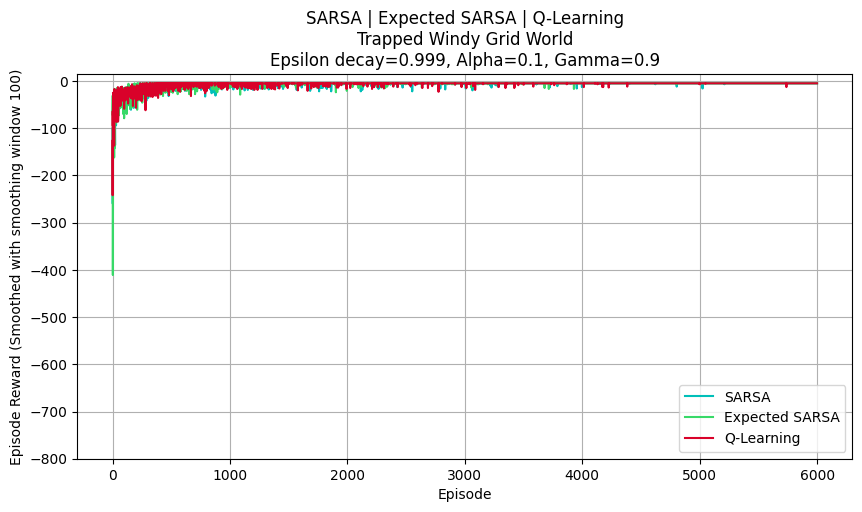

In [71]:
def plot_episode_rewards(ax, rewards, legend_label, color, smoothing_window=10):
    # rewards_smoothed = pd.Series(rewards).rolling(smoothing_window, min_periods=smoothing_window).mean()
    ax.plot(rewards, label=legend_label, color=color)

smoothing_window = 100

fig, ax = plt.subplots(figsize=(10,5))
ax.set_title(f"SARSA | Expected SARSA | Q-Learning\nTrapped Windy Grid World\nEpsilon decay={epsilon_decay}, Alpha={alpha}, Gamma={gamma}")
ax.set_xlabel("Episode")
ax.set_ylabel(f"Episode Reward (Smoothed with smoothing window {smoothing_window})")
plot_episode_rewards(ax, trap_king_sarsa_train_rewards, "SARSA", "#00bfb9", smoothing_window)
plot_episode_rewards(ax, trap_king_expsarsa_train_rewards, "Expected SARSA", "#38d968", smoothing_window)
plot_episode_rewards(ax, trap_king_ql_train_rewards, "Q-Learning", "#d9022a", smoothing_window)

#ax.set_xlim(-10, 1000)
#ax.set_ylim(bottom=-400)
ax.grid(True)
ax.legend(loc='lower right')
plt.show()

### Discussion:
#### - Q-Learning has bad results at the first 1000 episodes, but is performing as good as the other two algorithms after 1000 episodes.
#### - Expected SARSA and SARSA are overall the best algorithm to use in this environment.

## Conclusion

#### In conclusion, value iteration is the best algorithm in this assignment as it takes the least amount of time to train while still constantly providing the highest possible amount of reward.

#### SARSA, Q-Learning and Expected SARSA algorithms still provides very high reward value even if they slightly take longer time than value iteration.

#### These four algorithms will be our first choices to be used in our upcoming deep reinforcement learning.